In [1]:
import zipfile
import h5py
import os
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from PIL import Image
from sklearn.model_selection import StratifiedKFold
from sklearn.metrics import classification_report, confusion_matrix, ConfusionMatrixDisplay, accuracy_score, f1_score, recall_score
import tensorflow as tf
from sklearn.model_selection import StratifiedKFold
from sklearn.preprocessing import LabelEncoder
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.applications import MobileNetV2
from tensorflow.keras.applications.mobilenet_v2 import preprocess_input, decode_predictions
from tensorflow.keras.layers import Dense, GlobalAveragePooling2D
from tensorflow.keras.models import Model, load_model
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.callbacks import EarlyStopping, ModelCheckpoint
from tensorflow.keras.preprocessing.image import array_to_img
from tensorflow.keras.regularizers import l2
from keras.utils import to_categorical

%matplotlib inline
np.random.seed(42)

In [3]:
# Parameter
IMAGE_WIDTH = 224
IMAGE_HEIGHT = 224
COLOR_CHANNELS = 3
BATCH_SIZE = 32
EPOCHS = 25
K = 5  # Jumlah fold

In [3]:
data_dir = '../../Dataset/Dataset_Nusantara_7_split_stratified/train'

# Membuat dataframe dari dataset
image_paths = []
labels = []

for class_name in os.listdir(data_dir):
    class_dir = os.path.join(data_dir, class_name)
    if os.path.isdir(class_dir):  
        for img_name in os.listdir(class_dir):
            image_paths.append(os.path.join(class_dir, img_name))
            labels.append(class_name)

df = pd.DataFrame({"filename": image_paths, "class": labels})

# Konversi label ke angka
label_encoder = LabelEncoder()
df["label"] = label_encoder.fit_transform(df["class"])

print("✅ Dataset berhasil dimuat! Jumlah data:", len(df))
pd.set_option('display.max_colwidth', None)
df.head(len(df))

✅ Dataset berhasil dimuat! Jumlah data: 1590


,filename,class,label
0,../../Dataset/Dataset_Nusantara_7_split_stratified/train\JawaBarat_Megamendung\Mega_Mendung_0.jpg,JawaBarat_Megamendung,0
1,../../Dataset/Dataset_Nusantara_7_split_stratified/train\JawaBarat_Megamendung\Mega_Mendung_10.jpg,JawaBarat_Megamendung,0
2,../../Dataset/Dataset_Nusantara_7_split_stratified/train\JawaBarat_Megamendung\Mega_Mendung_101.jpg,JawaBarat_Megamendung,0
3,../../Dataset/Dataset_Nusantara_7_split_stratified/train\JawaBarat_Megamendung\Mega_Mendung_102.jpg,JawaBarat_Megamendung,0
4,../../Dataset/Dataset_Nusantara_7_split_stratified/train\JawaBarat_Megamendung\Mega_Mendung_104.jpg,JawaBarat_Megamendung,0
...,...,...,...
1585,../../Dataset/Dataset_Nusantara_7_split_stratified/train\Yogyakarta_Kawung\Kawung_92.jpg,Yogyakarta_Kawung,6
1586,../../Dataset/Dataset_Nusantara_7_split_stratified/train\Yogyakarta_Kawung\Kawung_93.jpg,Yogyakarta_Kawung,6
1587,../../Dataset/Dataset_Nusantara_7_split_stratified/train\Yogyakarta_Kawung\Kawung_94.jpg,Yogyakarta_Kawung,6
1588,../../Dataset/Dataset_Nusantara_7_split_stratified/train\Yogyakarta_Kawung\Kawung_96.jpg,Yogyakarta_Kawung,6


In [7]:
# Fungsi untuk membuat model MobileNetV2
def create_model():
    base_model = tf.keras.applications.mobilenet_v2.MobileNetV2(
        weights="imagenet", include_top=False, input_shape=(IMAGE_WIDTH, IMAGE_HEIGHT, COLOR_CHANNELS)
    )
    
    # Membekukan base model (tidak dilatih ulang)
    base_model.trainable = False

    x = base_model.output
    x = GlobalAveragePooling2D()(x)

    # Menambahkan layer output
    predictions = Dense(len(label_encoder.classes_), activation="softmax")(x)

    model = Model(inputs=base_model.input, outputs=predictions)

    # Compile model
    model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])

    return model

# Cek model
model = create_model()
model.summary()


Model: "functional_2"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer_2       │ (None, 224, 224,  │          0 │ -                 │
│ (InputLayer)        │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ Conv1 (Conv2D)      │ (None, 112, 112,  │        864 │ input_layer_2[0]… │
│                     │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ bn_Conv1            │ (None, 112, 112,  │        128 │ Conv1[0][0]       │
│ (BatchNormalizatio… │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ Conv1_relu (ReLU)   │ (None, 112, 112,  │          0 │ bn_Conv1[0][0]    │
│                     │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ expanded_conv_dept… │ (None, 112, 112,  │        288 │ Conv1_relu[0][0]  │
│ (DepthwiseConv2D)   │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ expanded_conv_dept… │ (None, 112, 112,  │        128 │ expanded_conv_de… │
│ (BatchNormalizatio… │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ expanded_conv_dept… │ (None, 112, 112,  │          0 │ expanded_conv_de… │
│ (ReLU)              │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ expanded_conv_proj… │ (None, 112, 112,  │        512 │ expanded_conv_de… │
│ (Conv2D)            │ 16)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ expanded_conv_proj… │ (None, 112, 112,  │         64 │ expanded_conv_pr… │
│ (BatchNormalizatio… │ 16)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block_1_expand      │ (None, 112, 112,  │      1,536 │ expanded_conv_pr… │
│ (Conv2D)            │ 96)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block_1_expand_BN   │ (None, 112, 112,  │        384 │ block_1_expand[0… │
│ (BatchNormalizatio… │ 96)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block_1_expand_relu │ (None, 112, 112,  │          0 │ block_1_expand_B… │
│ (ReLU)              │ 96)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block_1_pad         │ (None, 113, 113,  │          0 │ block_1_expand_r… │
│ (ZeroPadding2D)     │ 96)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block_1_depthwise   │ (None, 56, 56,    │        864 │ block_1_pad[0][0] │
│ (DepthwiseConv2D)   │ 96)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block_1_depthwise_… │ (None, 56, 56,    │        384 │ block_1_depthwis… │
│ (BatchNormalizatio… │ 96)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block_1_depthwise_… │ (None, 56, 56,    │          0 │ block_1_depthwis… │
│ (ReLU)              │ 96)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block_1_project     │ (None, 56, 56,    │      2,304 │ block_1_depthwis

 Total params: 2,266,951 (8.65 MB)

 Trainable params: 8,967 (35.03 KB)

 Non-trainable params: 2,257,984 (8.61 MB)


🔹 Training Fold 1/5
Found 1272 validated image filenames belonging to 7 classes.
Found 318 validated image filenames belonging to 7 classes.


C:\Users\VITO KA\AppData\Roaming\Python\Python310\site-packages\keras\src\trainers\data_adapters\py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/25
10/40 ━━━━━━━━━━━━━━━━━━━━ 28s 965ms/step - accuracy: 0.1407 - loss: 2.3146

c:\Users\VITO KA\AppData\Local\Programs\Python\Python310\lib\site-packages\PIL\Image.py:1045: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  warnings.warn(


40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 956ms/step - accuracy: 0.3587 - loss: 1.7230
Epoch 1: val_loss improved from inf to 0.50788, saving model to Batik_Nusantara_7_MobileNetV2_Fold1.h5


40/40 ━━━━━━━━━━━━━━━━━━━━ 53s 1s/step - accuracy: 0.3643 - loss: 1.7096 - val_accuracy: 0.8396 - val_loss: 0.5079
Epoch 2/25
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 745ms/step - accuracy: 0.8905 - loss: 0.4231
Epoch 2: val_loss improved from 0.50788 to 0.32564, saving model to Batik_Nusantara_7_MobileNetV2_Fold1.h5


40/40 ━━━━━━━━━━━━━━━━━━━━ 37s 939ms/step - accuracy: 0.8906 - loss: 0.4221 - val_accuracy: 0.9182 - val_loss: 0.3256
Epoch 3/25
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 701ms/step - accuracy: 0.9532 - loss: 0.2493
Epoch 3: val_loss improved from 0.32564 to 0.27194, saving model to Batik_Nusantara_7_MobileNetV2_Fold1.h5


40/40 ━━━━━━━━━━━━━━━━━━━━ 35s 874ms/step - accuracy: 0.9530 - loss: 0.2492 - val_accuracy: 0.9340 - val_loss: 0.2719
Epoch 4/25
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 679ms/step - accuracy: 0.9674 - loss: 0.1791
Epoch 4: val_loss improved from 0.27194 to 0.23040, saving model to Batik_Nusantara_7_MobileNetV2_Fold1.h5


40/40 ━━━━━━━━━━━━━━━━━━━━ 34s 852ms/step - accuracy: 0.9673 - loss: 0.1791 - val_accuracy: 0.9560 - val_loss: 0.2304
Epoch 5/25
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 712ms/step - accuracy: 0.9657 - loss: 0.1571
Epoch 5: val_loss improved from 0.23040 to 0.21492, saving model to Batik_Nusantara_7_MobileNetV2_Fold1.h5


40/40 ━━━━━━━━━━━━━━━━━━━━ 37s 938ms/step - accuracy: 0.9659 - loss: 0.1567 - val_accuracy: 0.9560 - val_loss: 0.2149
Epoch 6/25
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 618ms/step - accuracy: 0.9865 - loss: 0.1045
Epoch 6: val_loss improved from 0.21492 to 0.20516, saving model to Batik_Nusantara_7_MobileNetV2_Fold1.h5


40/40 ━━━━━━━━━━━━━━━━━━━━ 31s 775ms/step - accuracy: 0.9864 - loss: 0.1047 - val_accuracy: 0.9560 - val_loss: 0.2052
Epoch 7/25
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 608ms/step - accuracy: 0.9869 - loss: 0.0942
Epoch 7: val_loss improved from 0.20516 to 0.18369, saving model to Batik_Nusantara_7_MobileNetV2_Fold1.h5


40/40 ━━━━━━━━━━━━━━━━━━━━ 30s 761ms/step - accuracy: 0.9870 - loss: 0.0942 - val_accuracy: 0.9623 - val_loss: 0.1837
Epoch 8/25
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 617ms/step - accuracy: 0.9944 - loss: 0.0713
Epoch 8: val_loss improved from 0.18369 to 0.17809, saving model to Batik_Nusantara_7_MobileNetV2_Fold1.h5


40/40 ━━━━━━━━━━━━━━━━━━━━ 31s 773ms/step - accuracy: 0.9943 - loss: 0.0715 - val_accuracy: 0.9654 - val_loss: 0.1781
Epoch 9/25
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 608ms/step - accuracy: 0.9957 - loss: 0.0624
Epoch 9: val_loss improved from 0.17809 to 0.17252, saving model to Batik_Nusantara_7_MobileNetV2_Fold1.h5


40/40 ━━━━━━━━━━━━━━━━━━━━ 31s 762ms/step - accuracy: 0.9956 - loss: 0.0624 - val_accuracy: 0.9654 - val_loss: 0.1725
Epoch 10/25
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 611ms/step - accuracy: 0.9967 - loss: 0.0574
Epoch 10: val_loss improved from 0.17252 to 0.16697, saving model to Batik_Nusantara_7_MobileNetV2_Fold1.h5


40/40 ━━━━━━━━━━━━━━━━━━━━ 31s 763ms/step - accuracy: 0.9967 - loss: 0.0574 - val_accuracy: 0.9686 - val_loss: 0.1670
Epoch 11/25
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 584ms/step - accuracy: 0.9966 - loss: 0.0526
Epoch 11: val_loss improved from 0.16697 to 0.16397, saving model to Batik_Nusantara_7_MobileNetV2_Fold1.h5


40/40 ━━━━━━━━━━━━━━━━━━━━ 30s 735ms/step - accuracy: 0.9966 - loss: 0.0525 - val_accuracy: 0.9654 - val_loss: 0.1640
Epoch 12/25
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 602ms/step - accuracy: 0.9988 - loss: 0.0461
Epoch 12: val_loss improved from 0.16397 to 0.16198, saving model to Batik_Nusantara_7_MobileNetV2_Fold1.h5


40/40 ━━━━━━━━━━━━━━━━━━━━ 31s 769ms/step - accuracy: 0.9988 - loss: 0.0460 - val_accuracy: 0.9686 - val_loss: 0.1620
Epoch 13/25
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 700ms/step - accuracy: 0.9996 - loss: 0.0359
Epoch 13: val_loss improved from 0.16198 to 0.15933, saving model to Batik_Nusantara_7_MobileNetV2_Fold1.h5


40/40 ━━━━━━━━━━━━━━━━━━━━ 34s 852ms/step - accuracy: 0.9996 - loss: 0.0359 - val_accuracy: 0.9686 - val_loss: 0.1593
Epoch 14/25
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 595ms/step - accuracy: 0.9980 - loss: 0.0363
Epoch 14: val_loss improved from 0.15933 to 0.15846, saving model to Batik_Nusantara_7_MobileNetV2_Fold1.h5


40/40 ━━━━━━━━━━━━━━━━━━━━ 30s 748ms/step - accuracy: 0.9980 - loss: 0.0362 - val_accuracy: 0.9686 - val_loss: 0.1585
Epoch 15/25
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 598ms/step - accuracy: 0.9998 - loss: 0.0286
Epoch 15: val_loss improved from 0.15846 to 0.15471, saving model to Batik_Nusantara_7_MobileNetV2_Fold1.h5


40/40 ━━━━━━━━━━━━━━━━━━━━ 30s 749ms/step - accuracy: 0.9998 - loss: 0.0286 - val_accuracy: 0.9654 - val_loss: 0.1547
Epoch 16/25
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 592ms/step - accuracy: 0.9998 - loss: 0.0277
Epoch 16: val_loss did not improve from 0.15471
40/40 ━━━━━━━━━━━━━━━━━━━━ 30s 739ms/step - accuracy: 0.9998 - loss: 0.0277 - val_accuracy: 0.9686 - val_loss: 0.1565
Epoch 17/25
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 600ms/step - accuracy: 0.9996 - loss: 0.0261
Epoch 17: val_loss improved from 0.15471 to 0.15370, saving model to Batik_Nusantara_7_MobileNetV2_Fold1.h5


40/40 ━━━━━━━━━━━━━━━━━━━━ 30s 751ms/step - accuracy: 0.9996 - loss: 0.0260 - val_accuracy: 0.9654 - val_loss: 0.1537
Epoch 18/25
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 597ms/step - accuracy: 0.9996 - loss: 0.0223
Epoch 18: val_loss did not improve from 0.15370
40/40 ━━━━━━━━━━━━━━━━━━━━ 30s 743ms/step - accuracy: 0.9996 - loss: 0.0223 - val_accuracy: 0.9686 - val_loss: 0.1539
Epoch 19/25
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 595ms/step - accuracy: 1.0000 - loss: 0.0212
Epoch 19: val_loss improved from 0.15370 to 0.15270, saving model to Batik_Nusantara_7_MobileNetV2_Fold1.h5


40/40 ━━━━━━━━━━━━━━━━━━━━ 30s 746ms/step - accuracy: 1.0000 - loss: 0.0212 - val_accuracy: 0.9686 - val_loss: 0.1527
Epoch 20/25
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 601ms/step - accuracy: 0.9996 - loss: 0.0182
Epoch 20: val_loss improved from 0.15270 to 0.15155, saving model to Batik_Nusantara_7_MobileNetV2_Fold1.h5


40/40 ━━━━━━━━━━━━━━━━━━━━ 30s 760ms/step - accuracy: 0.9996 - loss: 0.0182 - val_accuracy: 0.9686 - val_loss: 0.1515
Epoch 21/25
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 599ms/step - accuracy: 1.0000 - loss: 0.0163
Epoch 21: val_loss improved from 0.15155 to 0.15092, saving model to Batik_Nusantara_7_MobileNetV2_Fold1.h5


40/40 ━━━━━━━━━━━━━━━━━━━━ 30s 750ms/step - accuracy: 1.0000 - loss: 0.0163 - val_accuracy: 0.9686 - val_loss: 0.1509
Epoch 22/25
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 605ms/step - accuracy: 1.0000 - loss: 0.0166
Epoch 22: val_loss did not improve from 0.15092
40/40 ━━━━━━━━━━━━━━━━━━━━ 30s 750ms/step - accuracy: 1.0000 - loss: 0.0166 - val_accuracy: 0.9686 - val_loss: 0.1509
Epoch 23/25
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 595ms/step - accuracy: 0.9998 - loss: 0.0145
Epoch 23: val_loss improved from 0.15092 to 0.15039, saving model to Batik_Nusantara_7_MobileNetV2_Fold1.h5


40/40 ━━━━━━━━━━━━━━━━━━━━ 30s 746ms/step - accuracy: 0.9997 - loss: 0.0145 - val_accuracy: 0.9686 - val_loss: 0.1504
Epoch 24/25
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 592ms/step - accuracy: 1.0000 - loss: 0.0163
Epoch 24: val_loss improved from 0.15039 to 0.15006, saving model to Batik_Nusantara_7_MobileNetV2_Fold1.h5


40/40 ━━━━━━━━━━━━━━━━━━━━ 30s 745ms/step - accuracy: 1.0000 - loss: 0.0163 - val_accuracy: 0.9686 - val_loss: 0.1501
Epoch 25/25
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 601ms/step - accuracy: 1.0000 - loss: 0.0133
Epoch 25: val_loss improved from 0.15006 to 0.15000, saving model to Batik_Nusantara_7_MobileNetV2_Fold1.h5


40/40 ━━━━━━━━━━━━━━━━━━━━ 30s 753ms/step - accuracy: 1.0000 - loss: 0.0133 - val_accuracy: 0.9686 - val_loss: 0.1500


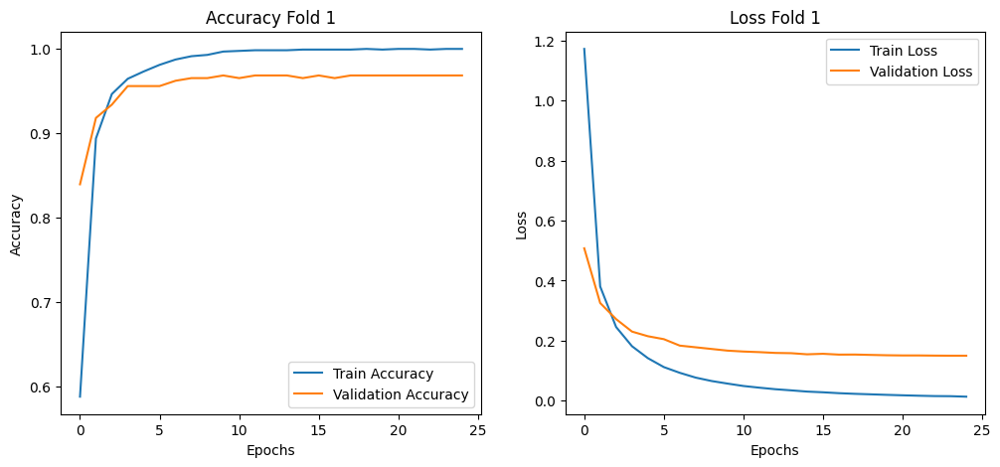


🔹 Training Fold 2/5
Found 1272 validated image filenames belonging to 7 classes.
Found 318 validated image filenames belonging to 7 classes.


C:\Users\VITO KA\AppData\Roaming\Python\Python310\site-packages\keras\src\trainers\data_adapters\py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/25
24/40 ━━━━━━━━━━━━━━━━━━━━ 8s 554ms/step - accuracy: 0.3019 - loss: 1.8678

c:\Users\VITO KA\AppData\Local\Programs\Python\Python310\lib\site-packages\PIL\Image.py:1045: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  warnings.warn(


40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 582ms/step - accuracy: 0.3973 - loss: 1.6250
Epoch 1: val_loss improved from inf to 0.52334, saving model to Batik_Nusantara_7_MobileNetV2_Fold2.h5


40/40 ━━━━━━━━━━━━━━━━━━━━ 35s 793ms/step - accuracy: 0.4022 - loss: 1.6130 - val_accuracy: 0.8585 - val_loss: 0.5233
Epoch 2/25
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 590ms/step - accuracy: 0.8859 - loss: 0.4025
Epoch 2: val_loss improved from 0.52334 to 0.34995, saving model to Batik_Nusantara_7_MobileNetV2_Fold2.h5


40/40 ━━━━━━━━━━━━━━━━━━━━ 30s 756ms/step - accuracy: 0.8862 - loss: 0.4015 - val_accuracy: 0.9151 - val_loss: 0.3500
Epoch 3/25
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 597ms/step - accuracy: 0.9362 - loss: 0.2381
Epoch 3: val_loss improved from 0.34995 to 0.28381, saving model to Batik_Nusantara_7_MobileNetV2_Fold2.h5


40/40 ━━━━━━━━━━━━━━━━━━━━ 31s 768ms/step - accuracy: 0.9364 - loss: 0.2380 - val_accuracy: 0.9434 - val_loss: 0.2838
Epoch 4/25
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 594ms/step - accuracy: 0.9709 - loss: 0.1736
Epoch 4: val_loss improved from 0.28381 to 0.26124, saving model to Batik_Nusantara_7_MobileNetV2_Fold2.h5


40/40 ━━━━━━━━━━━━━━━━━━━━ 31s 766ms/step - accuracy: 0.9710 - loss: 0.1734 - val_accuracy: 0.9403 - val_loss: 0.2612
Epoch 5/25
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 602ms/step - accuracy: 0.9768 - loss: 0.1250
Epoch 5: val_loss improved from 0.26124 to 0.23542, saving model to Batik_Nusantara_7_MobileNetV2_Fold2.h5


40/40 ━━━━━━━━━━━━━━━━━━━━ 31s 773ms/step - accuracy: 0.9769 - loss: 0.1250 - val_accuracy: 0.9371 - val_loss: 0.2354
Epoch 6/25
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 627ms/step - accuracy: 0.9856 - loss: 0.1038
Epoch 6: val_loss improved from 0.23542 to 0.21586, saving model to Batik_Nusantara_7_MobileNetV2_Fold2.h5


40/40 ━━━━━━━━━━━━━━━━━━━━ 34s 843ms/step - accuracy: 0.9855 - loss: 0.1037 - val_accuracy: 0.9497 - val_loss: 0.2159
Epoch 7/25
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 746ms/step - accuracy: 0.9909 - loss: 0.0787
Epoch 7: val_loss improved from 0.21586 to 0.20871, saving model to Batik_Nusantara_7_MobileNetV2_Fold2.h5


40/40 ━━━━━━━━━━━━━━━━━━━━ 37s 936ms/step - accuracy: 0.9910 - loss: 0.0788 - val_accuracy: 0.9465 - val_loss: 0.2087
Epoch 8/25
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 646ms/step - accuracy: 0.9987 - loss: 0.0680
Epoch 8: val_loss improved from 0.20871 to 0.20752, saving model to Batik_Nusantara_7_MobileNetV2_Fold2.h5


40/40 ━━━━━━━━━━━━━━━━━━━━ 33s 830ms/step - accuracy: 0.9987 - loss: 0.0679 - val_accuracy: 0.9403 - val_loss: 0.2075
Epoch 9/25
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 641ms/step - accuracy: 0.9967 - loss: 0.0619
Epoch 9: val_loss improved from 0.20752 to 0.19846, saving model to Batik_Nusantara_7_MobileNetV2_Fold2.h5


40/40 ━━━━━━━━━━━━━━━━━━━━ 33s 826ms/step - accuracy: 0.9967 - loss: 0.0618 - val_accuracy: 0.9528 - val_loss: 0.1985
Epoch 10/25
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 643ms/step - accuracy: 0.9998 - loss: 0.0456
Epoch 10: val_loss improved from 0.19846 to 0.19656, saving model to Batik_Nusantara_7_MobileNetV2_Fold2.h5


40/40 ━━━━━━━━━━━━━━━━━━━━ 33s 828ms/step - accuracy: 0.9998 - loss: 0.0457 - val_accuracy: 0.9497 - val_loss: 0.1966
Epoch 11/25
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 664ms/step - accuracy: 0.9981 - loss: 0.0411
Epoch 11: val_loss improved from 0.19656 to 0.19598, saving model to Batik_Nusantara_7_MobileNetV2_Fold2.h5


40/40 ━━━━━━━━━━━━━━━━━━━━ 35s 873ms/step - accuracy: 0.9981 - loss: 0.0411 - val_accuracy: 0.9465 - val_loss: 0.1960
Epoch 12/25
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 661ms/step - accuracy: 0.9989 - loss: 0.0382
Epoch 12: val_loss improved from 0.19598 to 0.19108, saving model to Batik_Nusantara_7_MobileNetV2_Fold2.h5


40/40 ━━━━━━━━━━━━━━━━━━━━ 34s 845ms/step - accuracy: 0.9989 - loss: 0.0382 - val_accuracy: 0.9528 - val_loss: 0.1911
Epoch 13/25
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 642ms/step - accuracy: 1.0000 - loss: 0.0324
Epoch 13: val_loss did not improve from 0.19108
40/40 ━━━━━━━━━━━━━━━━━━━━ 33s 818ms/step - accuracy: 1.0000 - loss: 0.0324 - val_accuracy: 0.9465 - val_loss: 0.1915
Epoch 14/25
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 644ms/step - accuracy: 1.0000 - loss: 0.0308
Epoch 14: val_loss improved from 0.19108 to 0.18863, saving model to Batik_Nusantara_7_MobileNetV2_Fold2.h5


40/40 ━━━━━━━━━━━━━━━━━━━━ 33s 827ms/step - accuracy: 1.0000 - loss: 0.0308 - val_accuracy: 0.9497 - val_loss: 0.1886
Epoch 15/25
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 646ms/step - accuracy: 1.0000 - loss: 0.0253
Epoch 15: val_loss improved from 0.18863 to 0.18807, saving model to Batik_Nusantara_7_MobileNetV2_Fold2.h5


40/40 ━━━━━━━━━━━━━━━━━━━━ 33s 829ms/step - accuracy: 1.0000 - loss: 0.0253 - val_accuracy: 0.9497 - val_loss: 0.1881
Epoch 16/25
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 677ms/step - accuracy: 1.0000 - loss: 0.0229
Epoch 16: val_loss did not improve from 0.18807
40/40 ━━━━━━━━━━━━━━━━━━━━ 34s 856ms/step - accuracy: 1.0000 - loss: 0.0229 - val_accuracy: 0.9465 - val_loss: 0.1917
Epoch 17/25
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 637ms/step - accuracy: 1.0000 - loss: 0.0223
Epoch 17: val_loss did not improve from 0.18807
40/40 ━━━━━━━━━━━━━━━━━━━━ 33s 815ms/step - accuracy: 1.0000 - loss: 0.0223 - val_accuracy: 0.9465 - val_loss: 0.1932
Epoch 18/25
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 645ms/step - accuracy: 1.0000 - loss: 0.0191
Epoch 18: val_loss did not improve from 0.18807
40/40 ━━━━━━━━━━━━━━━━━━━━ 33s 820ms/step - accuracy: 1.0000 - loss: 0.0191 - val_accuracy: 0.9403 - val_loss: 0.1897
Epoch 19/25
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 642ms/step - accuracy: 1.0000 - loss: 0.0170
Epoch 19: val_loss did not improve f

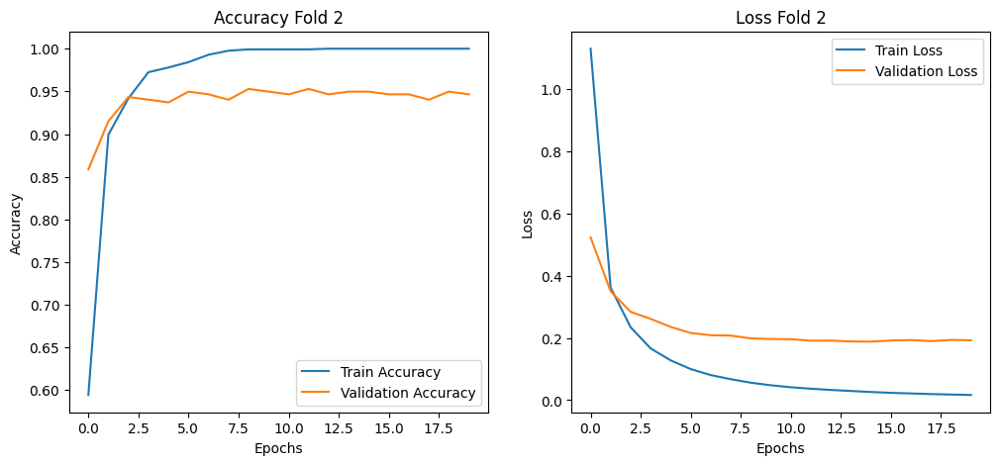


🔹 Training Fold 3/5
Found 1272 validated image filenames belonging to 7 classes.
Found 318 validated image filenames belonging to 7 classes.


C:\Users\VITO KA\AppData\Roaming\Python\Python310\site-packages\keras\src\trainers\data_adapters\py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/25
22/40 ━━━━━━━━━━━━━━━━━━━━ 11s 626ms/step - accuracy: 0.2976 - loss: 1.9235

c:\Users\VITO KA\AppData\Local\Programs\Python\Python310\lib\site-packages\PIL\Image.py:1045: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  warnings.warn(


40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 636ms/step - accuracy: 0.4089 - loss: 1.6380
Epoch 1: val_loss improved from inf to 0.54002, saving model to Batik_Nusantara_7_MobileNetV2_Fold3.h5


40/40 ━━━━━━━━━━━━━━━━━━━━ 38s 862ms/step - accuracy: 0.4139 - loss: 1.6258 - val_accuracy: 0.8553 - val_loss: 0.5400
Epoch 2/25
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 719ms/step - accuracy: 0.8852 - loss: 0.4003
Epoch 2: val_loss improved from 0.54002 to 0.37408, saving model to Batik_Nusantara_7_MobileNetV2_Fold3.h5


40/40 ━━━━━━━━━━━━━━━━━━━━ 37s 919ms/step - accuracy: 0.8856 - loss: 0.3995 - val_accuracy: 0.8994 - val_loss: 0.3741
Epoch 3/25
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 671ms/step - accuracy: 0.9469 - loss: 0.2449
Epoch 3: val_loss improved from 0.37408 to 0.31047, saving model to Batik_Nusantara_7_MobileNetV2_Fold3.h5


40/40 ━━━━━━━━━━━━━━━━━━━━ 34s 860ms/step - accuracy: 0.9469 - loss: 0.2446 - val_accuracy: 0.9119 - val_loss: 0.3105
Epoch 4/25
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 634ms/step - accuracy: 0.9697 - loss: 0.1684
Epoch 4: val_loss improved from 0.31047 to 0.28436, saving model to Batik_Nusantara_7_MobileNetV2_Fold3.h5


40/40 ━━━━━━━━━━━━━━━━━━━━ 33s 820ms/step - accuracy: 0.9696 - loss: 0.1685 - val_accuracy: 0.9214 - val_loss: 0.2844
Epoch 5/25
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 638ms/step - accuracy: 0.9715 - loss: 0.1341
Epoch 5: val_loss improved from 0.28436 to 0.26092, saving model to Batik_Nusantara_7_MobileNetV2_Fold3.h5


40/40 ━━━━━━━━━━━━━━━━━━━━ 33s 824ms/step - accuracy: 0.9716 - loss: 0.1342 - val_accuracy: 0.9277 - val_loss: 0.2609
Epoch 6/25
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 640ms/step - accuracy: 0.9890 - loss: 0.1075
Epoch 6: val_loss improved from 0.26092 to 0.24754, saving model to Batik_Nusantara_7_MobileNetV2_Fold3.h5


40/40 ━━━━━━━━━━━━━━━━━━━━ 33s 827ms/step - accuracy: 0.9889 - loss: 0.1075 - val_accuracy: 0.9371 - val_loss: 0.2475
Epoch 7/25
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 637ms/step - accuracy: 0.9926 - loss: 0.0851
Epoch 7: val_loss improved from 0.24754 to 0.23518, saving model to Batik_Nusantara_7_MobileNetV2_Fold3.h5


40/40 ━━━━━━━━━━━━━━━━━━━━ 33s 825ms/step - accuracy: 0.9924 - loss: 0.0852 - val_accuracy: 0.9371 - val_loss: 0.2352
Epoch 8/25
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 635ms/step - accuracy: 0.9901 - loss: 0.0805
Epoch 8: val_loss improved from 0.23518 to 0.23070, saving model to Batik_Nusantara_7_MobileNetV2_Fold3.h5


40/40 ━━━━━━━━━━━━━━━━━━━━ 33s 821ms/step - accuracy: 0.9902 - loss: 0.0803 - val_accuracy: 0.9434 - val_loss: 0.2307
Epoch 9/25
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 642ms/step - accuracy: 0.9952 - loss: 0.0570
Epoch 9: val_loss improved from 0.23070 to 0.22249, saving model to Batik_Nusantara_7_MobileNetV2_Fold3.h5


40/40 ━━━━━━━━━━━━━━━━━━━━ 33s 828ms/step - accuracy: 0.9952 - loss: 0.0571 - val_accuracy: 0.9465 - val_loss: 0.2225
Epoch 10/25
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 641ms/step - accuracy: 0.9958 - loss: 0.0557
Epoch 10: val_loss improved from 0.22249 to 0.21408, saving model to Batik_Nusantara_7_MobileNetV2_Fold3.h5


40/40 ━━━━━━━━━━━━━━━━━━━━ 33s 835ms/step - accuracy: 0.9958 - loss: 0.0556 - val_accuracy: 0.9465 - val_loss: 0.2141
Epoch 11/25
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 639ms/step - accuracy: 0.9961 - loss: 0.0477
Epoch 11: val_loss improved from 0.21408 to 0.21026, saving model to Batik_Nusantara_7_MobileNetV2_Fold3.h5


40/40 ━━━━━━━━━━━━━━━━━━━━ 33s 827ms/step - accuracy: 0.9961 - loss: 0.0476 - val_accuracy: 0.9497 - val_loss: 0.2103
Epoch 12/25
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 638ms/step - accuracy: 0.9975 - loss: 0.0386
Epoch 12: val_loss improved from 0.21026 to 0.20623, saving model to Batik_Nusantara_7_MobileNetV2_Fold3.h5


40/40 ━━━━━━━━━━━━━━━━━━━━ 33s 826ms/step - accuracy: 0.9975 - loss: 0.0386 - val_accuracy: 0.9528 - val_loss: 0.2062
Epoch 13/25
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 637ms/step - accuracy: 0.9978 - loss: 0.0354
Epoch 13: val_loss improved from 0.20623 to 0.20597, saving model to Batik_Nusantara_7_MobileNetV2_Fold3.h5


40/40 ━━━━━━━━━━━━━━━━━━━━ 33s 826ms/step - accuracy: 0.9979 - loss: 0.0354 - val_accuracy: 0.9403 - val_loss: 0.2060
Epoch 14/25
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 639ms/step - accuracy: 0.9996 - loss: 0.0328
Epoch 14: val_loss improved from 0.20597 to 0.20018, saving model to Batik_Nusantara_7_MobileNetV2_Fold3.h5


40/40 ━━━━━━━━━━━━━━━━━━━━ 33s 825ms/step - accuracy: 0.9996 - loss: 0.0328 - val_accuracy: 0.9560 - val_loss: 0.2002
Epoch 15/25
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 641ms/step - accuracy: 0.9978 - loss: 0.0286
Epoch 15: val_loss did not improve from 0.20018
40/40 ━━━━━━━━━━━━━━━━━━━━ 33s 821ms/step - accuracy: 0.9978 - loss: 0.0286 - val_accuracy: 0.9497 - val_loss: 0.2049
Epoch 16/25
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 638ms/step - accuracy: 0.9998 - loss: 0.0264
Epoch 16: val_loss improved from 0.20018 to 0.19645, saving model to Batik_Nusantara_7_MobileNetV2_Fold3.h5


40/40 ━━━━━━━━━━━━━━━━━━━━ 33s 825ms/step - accuracy: 0.9998 - loss: 0.0264 - val_accuracy: 0.9528 - val_loss: 0.1964
Epoch 17/25
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 641ms/step - accuracy: 1.0000 - loss: 0.0242
Epoch 17: val_loss did not improve from 0.19645
40/40 ━━━━━━━━━━━━━━━━━━━━ 33s 822ms/step - accuracy: 1.0000 - loss: 0.0242 - val_accuracy: 0.9560 - val_loss: 0.2005
Epoch 18/25
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 660ms/step - accuracy: 1.0000 - loss: 0.0187
Epoch 18: val_loss did not improve from 0.19645
40/40 ━━━━━━━━━━━━━━━━━━━━ 34s 863ms/step - accuracy: 1.0000 - loss: 0.0188 - val_accuracy: 0.9528 - val_loss: 0.1987
Epoch 19/25
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 677ms/step - accuracy: 0.9997 - loss: 0.0199
Epoch 19: val_loss improved from 0.19645 to 0.19571, saving model to Batik_Nusantara_7_MobileNetV2_Fold3.h5


40/40 ━━━━━━━━━━━━━━━━━━━━ 35s 871ms/step - accuracy: 0.9997 - loss: 0.0199 - val_accuracy: 0.9560 - val_loss: 0.1957
Epoch 20/25
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 657ms/step - accuracy: 1.0000 - loss: 0.0181
Epoch 20: val_loss did not improve from 0.19571
40/40 ━━━━━━━━━━━━━━━━━━━━ 34s 840ms/step - accuracy: 1.0000 - loss: 0.0181 - val_accuracy: 0.9560 - val_loss: 0.1963
Epoch 21/25
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 641ms/step - accuracy: 1.0000 - loss: 0.0159
Epoch 21: val_loss improved from 0.19571 to 0.19403, saving model to Batik_Nusantara_7_MobileNetV2_Fold3.h5


40/40 ━━━━━━━━━━━━━━━━━━━━ 33s 830ms/step - accuracy: 1.0000 - loss: 0.0159 - val_accuracy: 0.9560 - val_loss: 0.1940
Epoch 22/25
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 645ms/step - accuracy: 1.0000 - loss: 0.0157
Epoch 22: val_loss improved from 0.19403 to 0.19298, saving model to Batik_Nusantara_7_MobileNetV2_Fold3.h5


40/40 ━━━━━━━━━━━━━━━━━━━━ 33s 832ms/step - accuracy: 1.0000 - loss: 0.0157 - val_accuracy: 0.9528 - val_loss: 0.1930
Epoch 23/25
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 643ms/step - accuracy: 1.0000 - loss: 0.0144
Epoch 23: val_loss did not improve from 0.19298
40/40 ━━━━━━━━━━━━━━━━━━━━ 33s 824ms/step - accuracy: 1.0000 - loss: 0.0144 - val_accuracy: 0.9560 - val_loss: 0.1945
Epoch 24/25
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 687ms/step - accuracy: 1.0000 - loss: 0.0135
Epoch 24: val_loss did not improve from 0.19298
40/40 ━━━━━━━━━━━━━━━━━━━━ 35s 888ms/step - accuracy: 1.0000 - loss: 0.0135 - val_accuracy: 0.9497 - val_loss: 0.1958
Epoch 25/25
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 648ms/step - accuracy: 1.0000 - loss: 0.0116
Epoch 25: val_loss improved from 0.19298 to 0.19266, saving model to Batik_Nusantara_7_MobileNetV2_Fold3.h5


40/40 ━━━━━━━━━━━━━━━━━━━━ 34s 839ms/step - accuracy: 1.0000 - loss: 0.0116 - val_accuracy: 0.9560 - val_loss: 0.1927


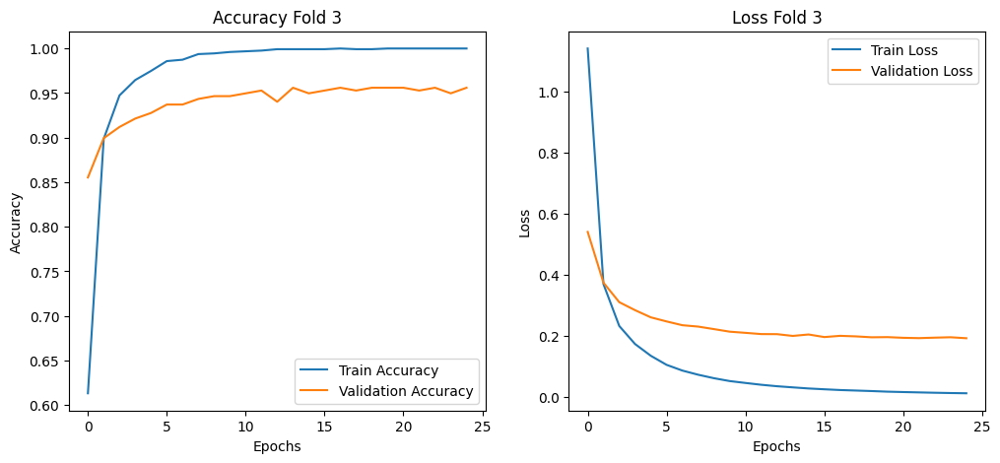


🔹 Training Fold 4/5
Found 1272 validated image filenames belonging to 7 classes.
Found 318 validated image filenames belonging to 7 classes.


C:\Users\VITO KA\AppData\Roaming\Python\Python310\site-packages\keras\src\trainers\data_adapters\py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()
c:\Users\VITO KA\AppData\Local\Programs\Python\Python310\lib\site-packages\PIL\Image.py:1045: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  warnings.warn(


Epoch 1/25
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 647ms/step - accuracy: 0.3585 - loss: 1.8365
Epoch 1: val_loss improved from inf to 0.52800, saving model to Batik_Nusantara_7_MobileNetV2_Fold4.h5


40/40 ━━━━━━━━━━━━━━━━━━━━ 38s 878ms/step - accuracy: 0.3636 - loss: 1.8224 - val_accuracy: 0.8616 - val_loss: 0.5280
Epoch 2/25
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 726ms/step - accuracy: 0.8922 - loss: 0.3943
Epoch 2: val_loss improved from 0.52800 to 0.31683, saving model to Batik_Nusantara_7_MobileNetV2_Fold4.h5


40/40 ━━━━━━━━━━━━━━━━━━━━ 37s 914ms/step - accuracy: 0.8919 - loss: 0.3942 - val_accuracy: 0.9245 - val_loss: 0.3168
Epoch 3/25
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 646ms/step - accuracy: 0.9344 - loss: 0.2602
Epoch 3: val_loss improved from 0.31683 to 0.24518, saving model to Batik_Nusantara_7_MobileNetV2_Fold4.h5


40/40 ━━━━━━━━━━━━━━━━━━━━ 33s 835ms/step - accuracy: 0.9346 - loss: 0.2599 - val_accuracy: 0.9308 - val_loss: 0.2452
Epoch 4/25
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 638ms/step - accuracy: 0.9620 - loss: 0.1914
Epoch 4: val_loss improved from 0.24518 to 0.21343, saving model to Batik_Nusantara_7_MobileNetV2_Fold4.h5


40/40 ━━━━━━━━━━━━━━━━━━━━ 33s 827ms/step - accuracy: 0.9620 - loss: 0.1911 - val_accuracy: 0.9465 - val_loss: 0.2134
Epoch 5/25
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 640ms/step - accuracy: 0.9737 - loss: 0.1437
Epoch 5: val_loss improved from 0.21343 to 0.19361, saving model to Batik_Nusantara_7_MobileNetV2_Fold4.h5


40/40 ━━━━━━━━━━━━━━━━━━━━ 33s 828ms/step - accuracy: 0.9738 - loss: 0.1436 - val_accuracy: 0.9497 - val_loss: 0.1936
Epoch 6/25
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 646ms/step - accuracy: 0.9864 - loss: 0.1061
Epoch 6: val_loss improved from 0.19361 to 0.17478, saving model to Batik_Nusantara_7_MobileNetV2_Fold4.h5


40/40 ━━━━━━━━━━━━━━━━━━━━ 33s 836ms/step - accuracy: 0.9864 - loss: 0.1062 - val_accuracy: 0.9528 - val_loss: 0.1748
Epoch 7/25
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 640ms/step - accuracy: 0.9884 - loss: 0.0898
Epoch 7: val_loss improved from 0.17478 to 0.16068, saving model to Batik_Nusantara_7_MobileNetV2_Fold4.h5


40/40 ━━━━━━━━━━━━━━━━━━━━ 33s 829ms/step - accuracy: 0.9884 - loss: 0.0897 - val_accuracy: 0.9623 - val_loss: 0.1607
Epoch 8/25
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 641ms/step - accuracy: 0.9955 - loss: 0.0767
Epoch 8: val_loss improved from 0.16068 to 0.15435, saving model to Batik_Nusantara_7_MobileNetV2_Fold4.h5


40/40 ━━━━━━━━━━━━━━━━━━━━ 33s 828ms/step - accuracy: 0.9954 - loss: 0.0767 - val_accuracy: 0.9591 - val_loss: 0.1543
Epoch 9/25
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 660ms/step - accuracy: 0.9962 - loss: 0.0646
Epoch 9: val_loss improved from 0.15435 to 0.14879, saving model to Batik_Nusantara_7_MobileNetV2_Fold4.h5


40/40 ━━━━━━━━━━━━━━━━━━━━ 34s 849ms/step - accuracy: 0.9962 - loss: 0.0646 - val_accuracy: 0.9528 - val_loss: 0.1488
Epoch 10/25
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 637ms/step - accuracy: 0.9966 - loss: 0.0556
Epoch 10: val_loss improved from 0.14879 to 0.14173, saving model to Batik_Nusantara_7_MobileNetV2_Fold4.h5


40/40 ━━━━━━━━━━━━━━━━━━━━ 33s 826ms/step - accuracy: 0.9966 - loss: 0.0556 - val_accuracy: 0.9591 - val_loss: 0.1417
Epoch 11/25
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 640ms/step - accuracy: 0.9987 - loss: 0.0450
Epoch 11: val_loss improved from 0.14173 to 0.13611, saving model to Batik_Nusantara_7_MobileNetV2_Fold4.h5


40/40 ━━━━━━━━━━━━━━━━━━━━ 33s 831ms/step - accuracy: 0.9986 - loss: 0.0451 - val_accuracy: 0.9623 - val_loss: 0.1361
Epoch 12/25
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 644ms/step - accuracy: 0.9975 - loss: 0.0435
Epoch 12: val_loss improved from 0.13611 to 0.13178, saving model to Batik_Nusantara_7_MobileNetV2_Fold4.h5


40/40 ━━━━━━━━━━━━━━━━━━━━ 33s 834ms/step - accuracy: 0.9976 - loss: 0.0435 - val_accuracy: 0.9654 - val_loss: 0.1318
Epoch 13/25
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 636ms/step - accuracy: 0.9979 - loss: 0.0395
Epoch 13: val_loss improved from 0.13178 to 0.12742, saving model to Batik_Nusantara_7_MobileNetV2_Fold4.h5


40/40 ━━━━━━━━━━━━━━━━━━━━ 33s 824ms/step - accuracy: 0.9979 - loss: 0.0395 - val_accuracy: 0.9591 - val_loss: 0.1274
Epoch 14/25
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 645ms/step - accuracy: 0.9989 - loss: 0.0310
Epoch 14: val_loss improved from 0.12742 to 0.12166, saving model to Batik_Nusantara_7_MobileNetV2_Fold4.h5


40/40 ━━━━━━━━━━━━━━━━━━━━ 33s 835ms/step - accuracy: 0.9989 - loss: 0.0311 - val_accuracy: 0.9623 - val_loss: 0.1217
Epoch 15/25
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 640ms/step - accuracy: 0.9998 - loss: 0.0326
Epoch 15: val_loss did not improve from 0.12166
40/40 ━━━━━━━━━━━━━━━━━━━━ 34s 839ms/step - accuracy: 0.9998 - loss: 0.0325 - val_accuracy: 0.9560 - val_loss: 0.1221
Epoch 16/25
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 662ms/step - accuracy: 0.9991 - loss: 0.0267
Epoch 16: val_loss improved from 0.12166 to 0.11878, saving model to Batik_Nusantara_7_MobileNetV2_Fold4.h5


40/40 ━━━━━━━━━━━━━━━━━━━━ 35s 866ms/step - accuracy: 0.9991 - loss: 0.0267 - val_accuracy: 0.9591 - val_loss: 0.1188
Epoch 17/25
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 732ms/step - accuracy: 1.0000 - loss: 0.0245
Epoch 17: val_loss improved from 0.11878 to 0.11690, saving model to Batik_Nusantara_7_MobileNetV2_Fold4.h5


40/40 ━━━━━━━━━━━━━━━━━━━━ 37s 925ms/step - accuracy: 1.0000 - loss: 0.0245 - val_accuracy: 0.9591 - val_loss: 0.1169
Epoch 18/25
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 651ms/step - accuracy: 1.0000 - loss: 0.0233
Epoch 18: val_loss improved from 0.11690 to 0.11380, saving model to Batik_Nusantara_7_MobileNetV2_Fold4.h5


40/40 ━━━━━━━━━━━━━━━━━━━━ 34s 843ms/step - accuracy: 0.9999 - loss: 0.0233 - val_accuracy: 0.9623 - val_loss: 0.1138
Epoch 19/25
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 658ms/step - accuracy: 1.0000 - loss: 0.0205
Epoch 19: val_loss improved from 0.11380 to 0.11258, saving model to Batik_Nusantara_7_MobileNetV2_Fold4.h5


40/40 ━━━━━━━━━━━━━━━━━━━━ 34s 853ms/step - accuracy: 0.9999 - loss: 0.0205 - val_accuracy: 0.9623 - val_loss: 0.1126
Epoch 20/25
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 657ms/step - accuracy: 1.0000 - loss: 0.0192
Epoch 20: val_loss improved from 0.11258 to 0.11182, saving model to Batik_Nusantara_7_MobileNetV2_Fold4.h5


40/40 ━━━━━━━━━━━━━━━━━━━━ 34s 856ms/step - accuracy: 1.0000 - loss: 0.0192 - val_accuracy: 0.9623 - val_loss: 0.1118
Epoch 21/25
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 659ms/step - accuracy: 1.0000 - loss: 0.0167
Epoch 21: val_loss improved from 0.11182 to 0.11025, saving model to Batik_Nusantara_7_MobileNetV2_Fold4.h5


40/40 ━━━━━━━━━━━━━━━━━━━━ 34s 852ms/step - accuracy: 1.0000 - loss: 0.0167 - val_accuracy: 0.9591 - val_loss: 0.1102
Epoch 22/25
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 653ms/step - accuracy: 1.0000 - loss: 0.0175
Epoch 22: val_loss improved from 0.11025 to 0.10851, saving model to Batik_Nusantara_7_MobileNetV2_Fold4.h5


40/40 ━━━━━━━━━━━━━━━━━━━━ 34s 846ms/step - accuracy: 1.0000 - loss: 0.0175 - val_accuracy: 0.9591 - val_loss: 0.1085
Epoch 23/25
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 654ms/step - accuracy: 1.0000 - loss: 0.0150
Epoch 23: val_loss improved from 0.10851 to 0.10734, saving model to Batik_Nusantara_7_MobileNetV2_Fold4.h5


40/40 ━━━━━━━━━━━━━━━━━━━━ 34s 848ms/step - accuracy: 1.0000 - loss: 0.0150 - val_accuracy: 0.9591 - val_loss: 0.1073
Epoch 24/25
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 737ms/step - accuracy: 1.0000 - loss: 0.0169
Epoch 24: val_loss improved from 0.10734 to 0.10644, saving model to Batik_Nusantara_7_MobileNetV2_Fold4.h5


40/40 ━━━━━━━━━━━━━━━━━━━━ 38s 953ms/step - accuracy: 1.0000 - loss: 0.0168 - val_accuracy: 0.9591 - val_loss: 0.1064
Epoch 25/25
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 745ms/step - accuracy: 1.0000 - loss: 0.0142
Epoch 25: val_loss did not improve from 0.10644
40/40 ━━━━━━━━━━━━━━━━━━━━ 38s 948ms/step - accuracy: 1.0000 - loss: 0.0142 - val_accuracy: 0.9591 - val_loss: 0.1066


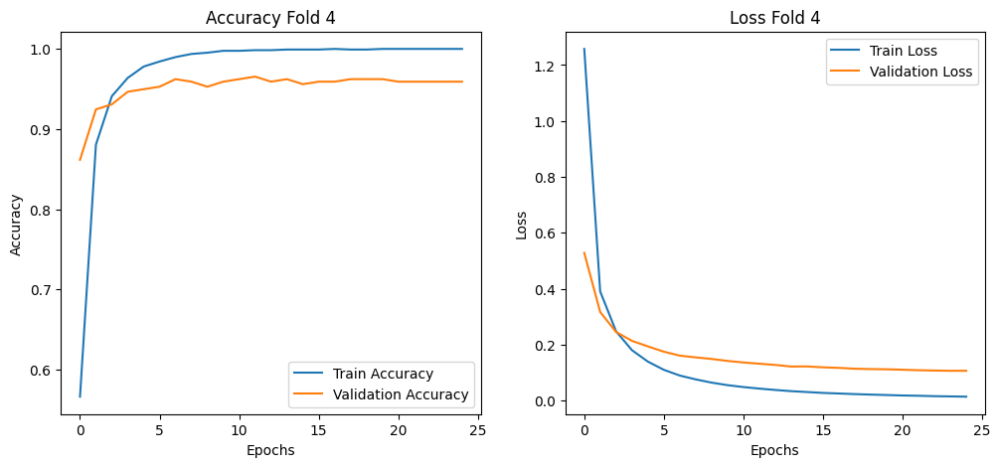


🔹 Training Fold 5/5
Found 1272 validated image filenames belonging to 7 classes.
Found 318 validated image filenames belonging to 7 classes.


C:\Users\VITO KA\AppData\Roaming\Python\Python310\site-packages\keras\src\trainers\data_adapters\py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/25
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 760ms/step - accuracy: 0.3684 - loss: 1.7946

c:\Users\VITO KA\AppData\Local\Programs\Python\Python310\lib\site-packages\PIL\Image.py:1045: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  warnings.warn(



Epoch 1: val_loss improved from inf to 0.60819, saving model to Batik_Nusantara_7_MobileNetV2_Fold5.h5


40/40 ━━━━━━━━━━━━━━━━━━━━ 43s 1s/step - accuracy: 0.3734 - loss: 1.7806 - val_accuracy: 0.8082 - val_loss: 0.6082
Epoch 2/25
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 733ms/step - accuracy: 0.8841 - loss: 0.4423
Epoch 2: val_loss improved from 0.60819 to 0.41281, saving model to Batik_Nusantara_7_MobileNetV2_Fold5.h5


40/40 ━━━━━━━━━━━━━━━━━━━━ 36s 907ms/step - accuracy: 0.8845 - loss: 0.4408 - val_accuracy: 0.8711 - val_loss: 0.4128
Epoch 3/25
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 661ms/step - accuracy: 0.9478 - loss: 0.2578
Epoch 3: val_loss improved from 0.41281 to 0.33414, saving model to Batik_Nusantara_7_MobileNetV2_Fold5.h5


40/40 ━━━━━━━━━━━━━━━━━━━━ 33s 834ms/step - accuracy: 0.9476 - loss: 0.2577 - val_accuracy: 0.9088 - val_loss: 0.3341
Epoch 4/25
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 657ms/step - accuracy: 0.9519 - loss: 0.2061
Epoch 4: val_loss improved from 0.33414 to 0.28583, saving model to Batik_Nusantara_7_MobileNetV2_Fold5.h5


40/40 ━━━━━━━━━━━━━━━━━━━━ 33s 830ms/step - accuracy: 0.9521 - loss: 0.2056 - val_accuracy: 0.9277 - val_loss: 0.2858
Epoch 5/25
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 665ms/step - accuracy: 0.9611 - loss: 0.1598
Epoch 5: val_loss improved from 0.28583 to 0.25181, saving model to Batik_Nusantara_7_MobileNetV2_Fold5.h5


40/40 ━━━━━━━━━━━━━━━━━━━━ 33s 839ms/step - accuracy: 0.9613 - loss: 0.1594 - val_accuracy: 0.9340 - val_loss: 0.2518
Epoch 6/25
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 656ms/step - accuracy: 0.9731 - loss: 0.1192
Epoch 6: val_loss improved from 0.25181 to 0.23234, saving model to Batik_Nusantara_7_MobileNetV2_Fold5.h5


40/40 ━━━━━━━━━━━━━━━━━━━━ 33s 833ms/step - accuracy: 0.9732 - loss: 0.1191 - val_accuracy: 0.9371 - val_loss: 0.2323
Epoch 7/25
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 658ms/step - accuracy: 0.9875 - loss: 0.0918
Epoch 7: val_loss improved from 0.23234 to 0.22284, saving model to Batik_Nusantara_7_MobileNetV2_Fold5.h5


40/40 ━━━━━━━━━━━━━━━━━━━━ 33s 835ms/step - accuracy: 0.9875 - loss: 0.0918 - val_accuracy: 0.9403 - val_loss: 0.2228
Epoch 8/25
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 656ms/step - accuracy: 0.9842 - loss: 0.0834
Epoch 8: val_loss improved from 0.22284 to 0.20773, saving model to Batik_Nusantara_7_MobileNetV2_Fold5.h5


40/40 ━━━━━━━━━━━━━━━━━━━━ 33s 830ms/step - accuracy: 0.9843 - loss: 0.0833 - val_accuracy: 0.9403 - val_loss: 0.2077
Epoch 9/25
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 663ms/step - accuracy: 0.9888 - loss: 0.0766
Epoch 9: val_loss improved from 0.20773 to 0.19780, saving model to Batik_Nusantara_7_MobileNetV2_Fold5.h5


40/40 ━━━━━━━━━━━━━━━━━━━━ 35s 878ms/step - accuracy: 0.9889 - loss: 0.0764 - val_accuracy: 0.9371 - val_loss: 0.1978
Epoch 10/25
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 692ms/step - accuracy: 0.9968 - loss: 0.0499
Epoch 10: val_loss improved from 0.19780 to 0.18989, saving model to Batik_Nusantara_7_MobileNetV2_Fold5.h5


40/40 ━━━━━━━━━━━━━━━━━━━━ 35s 865ms/step - accuracy: 0.9968 - loss: 0.0501 - val_accuracy: 0.9497 - val_loss: 0.1899
Epoch 11/25
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 661ms/step - accuracy: 0.9989 - loss: 0.0451
Epoch 11: val_loss improved from 0.18989 to 0.18685, saving model to Batik_Nusantara_7_MobileNetV2_Fold5.h5


40/40 ━━━━━━━━━━━━━━━━━━━━ 33s 835ms/step - accuracy: 0.9989 - loss: 0.0453 - val_accuracy: 0.9497 - val_loss: 0.1868
Epoch 12/25
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 664ms/step - accuracy: 0.9981 - loss: 0.0455
Epoch 12: val_loss improved from 0.18685 to 0.18231, saving model to Batik_Nusantara_7_MobileNetV2_Fold5.h5


40/40 ━━━━━━━━━━━━━━━━━━━━ 33s 838ms/step - accuracy: 0.9981 - loss: 0.0454 - val_accuracy: 0.9434 - val_loss: 0.1823
Epoch 13/25
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 661ms/step - accuracy: 0.9994 - loss: 0.0348
Epoch 13: val_loss improved from 0.18231 to 0.17750, saving model to Batik_Nusantara_7_MobileNetV2_Fold5.h5


40/40 ━━━━━━━━━━━━━━━━━━━━ 33s 835ms/step - accuracy: 0.9994 - loss: 0.0349 - val_accuracy: 0.9465 - val_loss: 0.1775
Epoch 14/25
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 660ms/step - accuracy: 1.0000 - loss: 0.0402
Epoch 14: val_loss improved from 0.17750 to 0.17302, saving model to Batik_Nusantara_7_MobileNetV2_Fold5.h5


40/40 ━━━━━━━━━━━━━━━━━━━━ 33s 837ms/step - accuracy: 1.0000 - loss: 0.0401 - val_accuracy: 0.9560 - val_loss: 0.1730
Epoch 15/25
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 666ms/step - accuracy: 1.0000 - loss: 0.0305
Epoch 15: val_loss improved from 0.17302 to 0.17238, saving model to Batik_Nusantara_7_MobileNetV2_Fold5.h5


40/40 ━━━━━━━━━━━━━━━━━━━━ 34s 843ms/step - accuracy: 1.0000 - loss: 0.0305 - val_accuracy: 0.9528 - val_loss: 0.1724
Epoch 16/25
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 661ms/step - accuracy: 1.0000 - loss: 0.0264
Epoch 16: val_loss improved from 0.17238 to 0.16813, saving model to Batik_Nusantara_7_MobileNetV2_Fold5.h5


40/40 ━━━━━━━━━━━━━━━━━━━━ 33s 835ms/step - accuracy: 1.0000 - loss: 0.0264 - val_accuracy: 0.9560 - val_loss: 0.1681
Epoch 17/25
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 671ms/step - accuracy: 1.0000 - loss: 0.0273
Epoch 17: val_loss improved from 0.16813 to 0.16790, saving model to Batik_Nusantara_7_MobileNetV2_Fold5.h5


40/40 ━━━━━━━━━━━━━━━━━━━━ 34s 844ms/step - accuracy: 1.0000 - loss: 0.0273 - val_accuracy: 0.9528 - val_loss: 0.1679
Epoch 18/25
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 743ms/step - accuracy: 1.0000 - loss: 0.0232
Epoch 18: val_loss improved from 0.16790 to 0.16717, saving model to Batik_Nusantara_7_MobileNetV2_Fold5.h5


40/40 ━━━━━━━━━━━━━━━━━━━━ 37s 916ms/step - accuracy: 1.0000 - loss: 0.0232 - val_accuracy: 0.9497 - val_loss: 0.1672
Epoch 19/25
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 683ms/step - accuracy: 1.0000 - loss: 0.0208
Epoch 19: val_loss improved from 0.16717 to 0.16485, saving model to Batik_Nusantara_7_MobileNetV2_Fold5.h5


40/40 ━━━━━━━━━━━━━━━━━━━━ 35s 867ms/step - accuracy: 1.0000 - loss: 0.0208 - val_accuracy: 0.9497 - val_loss: 0.1649
Epoch 20/25
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 699ms/step - accuracy: 1.0000 - loss: 0.0188
Epoch 20: val_loss improved from 0.16485 to 0.16431, saving model to Batik_Nusantara_7_MobileNetV2_Fold5.h5


40/40 ━━━━━━━━━━━━━━━━━━━━ 35s 873ms/step - accuracy: 1.0000 - loss: 0.0188 - val_accuracy: 0.9497 - val_loss: 0.1643
Epoch 21/25
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 658ms/step - accuracy: 1.0000 - loss: 0.0200
Epoch 21: val_loss improved from 0.16431 to 0.16292, saving model to Batik_Nusantara_7_MobileNetV2_Fold5.h5


40/40 ━━━━━━━━━━━━━━━━━━━━ 33s 836ms/step - accuracy: 1.0000 - loss: 0.0200 - val_accuracy: 0.9497 - val_loss: 0.1629
Epoch 22/25
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 657ms/step - accuracy: 1.0000 - loss: 0.0166
Epoch 22: val_loss improved from 0.16292 to 0.16255, saving model to Batik_Nusantara_7_MobileNetV2_Fold5.h5


40/40 ━━━━━━━━━━━━━━━━━━━━ 33s 834ms/step - accuracy: 1.0000 - loss: 0.0166 - val_accuracy: 0.9528 - val_loss: 0.1626
Epoch 23/25
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 660ms/step - accuracy: 1.0000 - loss: 0.0157
Epoch 23: val_loss improved from 0.16255 to 0.16114, saving model to Batik_Nusantara_7_MobileNetV2_Fold5.h5


40/40 ━━━━━━━━━━━━━━━━━━━━ 33s 835ms/step - accuracy: 1.0000 - loss: 0.0156 - val_accuracy: 0.9497 - val_loss: 0.1611
Epoch 24/25
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 651ms/step - accuracy: 1.0000 - loss: 0.0159
Epoch 24: val_loss did not improve from 0.16114
40/40 ━━━━━━━━━━━━━━━━━━━━ 33s 817ms/step - accuracy: 1.0000 - loss: 0.0159 - val_accuracy: 0.9528 - val_loss: 0.1620
Epoch 25/25
40/40 ━━━━━━━━━━━━━━━━━━━━ 0s 661ms/step - accuracy: 1.0000 - loss: 0.0136
Epoch 25: val_loss did not improve from 0.16114
40/40 ━━━━━━━━━━━━━━━━━━━━ 33s 827ms/step - accuracy: 1.0000 - loss: 0.0136 - val_accuracy: 0.9560 - val_loss: 0.1613


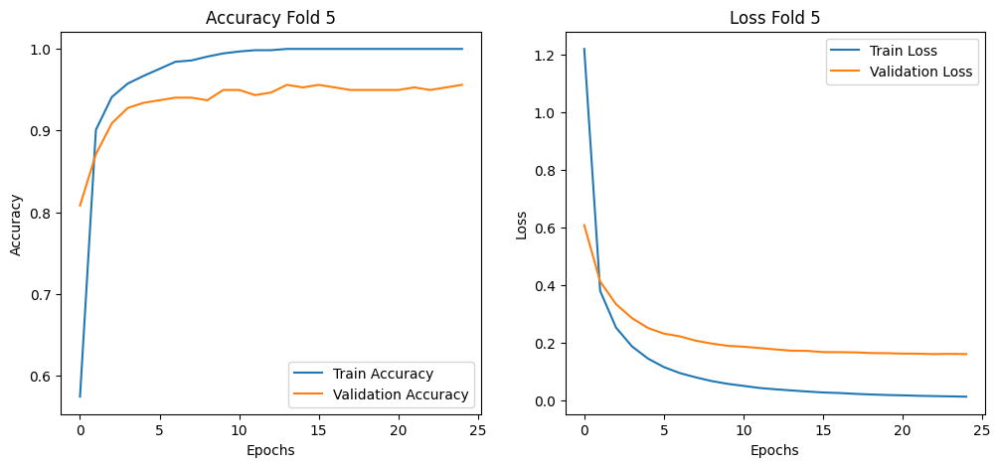


✅ Training selesai untuk semua fold!


In [8]:
# Stratified K-Fold
skf = StratifiedKFold(n_splits=K, shuffle=True, random_state=42)

# Melakukan K-Fold Cross Validation
for fold, (train_idx, val_idx) in enumerate(skf.split(df["filename"], df["label"])):
    print(f"\n🔹 Training Fold {fold+1}/{K}")

    # Membagi dataset berdasarkan indeks
    train_df = df.iloc[train_idx]
    val_df = df.iloc[val_idx]

    # Data augmentation dan preprocessing
    train_datagen = ImageDataGenerator(preprocessing_function=preprocess_input)
    val_datagen = ImageDataGenerator(preprocessing_function=preprocess_input)

    train_generator = train_datagen.flow_from_dataframe(
        train_df, x_col="filename", y_col="class",
        target_size=(IMAGE_HEIGHT, IMAGE_WIDTH), batch_size=BATCH_SIZE,
        class_mode="categorical", shuffle=True
    )

    val_generator = val_datagen.flow_from_dataframe(
        val_df, x_col="filename", y_col="class",
        target_size=(IMAGE_HEIGHT, IMAGE_WIDTH), batch_size=BATCH_SIZE,
        class_mode="categorical", shuffle=False
    )

    # Buat model baru untuk setiap fold
    model = create_model()

    # Callback untuk early stopping dan penyimpanan model terbaik
    early_stopping = EarlyStopping(monitor="val_loss", patience=5, restore_best_weights=True)
    model_checkpoint = ModelCheckpoint(f"Batik_Nusantara_7_MobileNetV2_Fold{fold+1}.h5",
                                       monitor="val_loss", save_best_only=True, mode="min", verbose=1)

    # Training model
    history = model.fit(
        train_generator,
        validation_data=val_generator,
        epochs=EPOCHS,
        callbacks=[early_stopping, model_checkpoint],
        verbose=1
    )

    # 🔹 Plot Training & Validation Accuracy untuk Fold ini
    plt.figure(figsize=(12, 5))

    plt.subplot(1, 2, 1)
    plt.plot(history.history['accuracy'], label='Train Accuracy')
    plt.plot(history.history['val_accuracy'], label='Validation Accuracy')
    plt.title(f'Accuracy Fold {fold+1}')
    plt.xlabel('Epochs')
    plt.ylabel('Accuracy')
    plt.legend()

    # 🔹 Plot Training & Validation Loss untuk Fold ini
    plt.subplot(1, 2, 2)
    plt.plot(history.history['loss'], label='Train Loss')
    plt.plot(history.history['val_loss'], label='Validation Loss')
    plt.title(f'Loss Fold {fold+1}')
    plt.xlabel('Epochs')
    plt.ylabel('Loss')
    plt.legend()

    plt.show()  # Menampilkan plot setelah setiap fold selesai

print("\n✅ Training selesai untuk semua fold!")


In [4]:
test_dir = "../../Dataset/Dataset_Nusantara_7_split_stratified/test"

# Preprocessing data testing
test_datagen = ImageDataGenerator(preprocessing_function=preprocess_input)

test_generator = test_datagen.flow_from_directory(
    test_dir,
    target_size=(IMAGE_HEIGHT, IMAGE_WIDTH),
    batch_size=BATCH_SIZE,
    class_mode="categorical",
    shuffle=False  # Agar urutan gambar tetap sama untuk semua model
)

# Evaluasi tiap model per fold
num_folds = 5  # Jumlah fold
models = [f"Batik_Nusantara_7_MobileNetV2_Fold{i+1}.h5" for i in range(num_folds)]

for i, model_path in enumerate(models):
    print(f"\n🔹 Evaluating Model Fold {i+1}: {model_path}")
    
    # Load model
    model = tf.keras.models.load_model(model_path)
    
    # Evaluasi model
    loss, accuracy = model.evaluate(test_generator, verbose=1)
    
    # Tampilkan hasil evaluasi
    print(f"✅ Fold {i+1}: Loss = {loss:.4f}, Accuracy = {accuracy:.4f}")


Found 398 images belonging to 7 classes.

🔹 Evaluating Model Fold 1: Batik_Nusantara_7_MobileNetV2_Fold1.h5


C:\Users\VITO KA\AppData\Roaming\Python\Python310\site-packages\keras\src\trainers\data_adapters\py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


13/13 ━━━━━━━━━━━━━━━━━━━━ 13s 821ms/step - accuracy: 0.9504 - loss: 0.1592
✅ Fold 1: Loss = 0.1793, Accuracy = 0.9497

🔹 Evaluating Model Fold 2: Batik_Nusantara_7_MobileNetV2_Fold2.h5


13/13 ━━━━━━━━━━━━━━━━━━━━ 16s 926ms/step - accuracy: 0.9478 - loss: 0.1524
✅ Fold 2: Loss = 0.1872, Accuracy = 0.9372

🔹 Evaluating Model Fold 3: Batik_Nusantara_7_MobileNetV2_Fold3.h5


13/13 ━━━━━━━━━━━━━━━━━━━━ 13s 767ms/step - accuracy: 0.9281 - loss: 0.1642
✅ Fold 3: Loss = 0.1981, Accuracy = 0.9296

🔹 Evaluating Model Fold 4: Batik_Nusantara_7_MobileNetV2_Fold4.h5


13/13 ━━━━━━━━━━━━━━━━━━━━ 12s 742ms/step - accuracy: 0.9520 - loss: 0.1486
✅ Fold 4: Loss = 0.1757, Accuracy = 0.9472

🔹 Evaluating Model Fold 5: Batik_Nusantara_7_MobileNetV2_Fold5.h5


13/13 ━━━━━━━━━━━━━━━━━━━━ 12s 760ms/step - accuracy: 0.9396 - loss: 0.1608
✅ Fold 5: Loss = 0.1954, Accuracy = 0.9397


Evaluasi Model KFold 1

13/13 ━━━━━━━━━━━━━━━━━━━━ 17s 1s/step


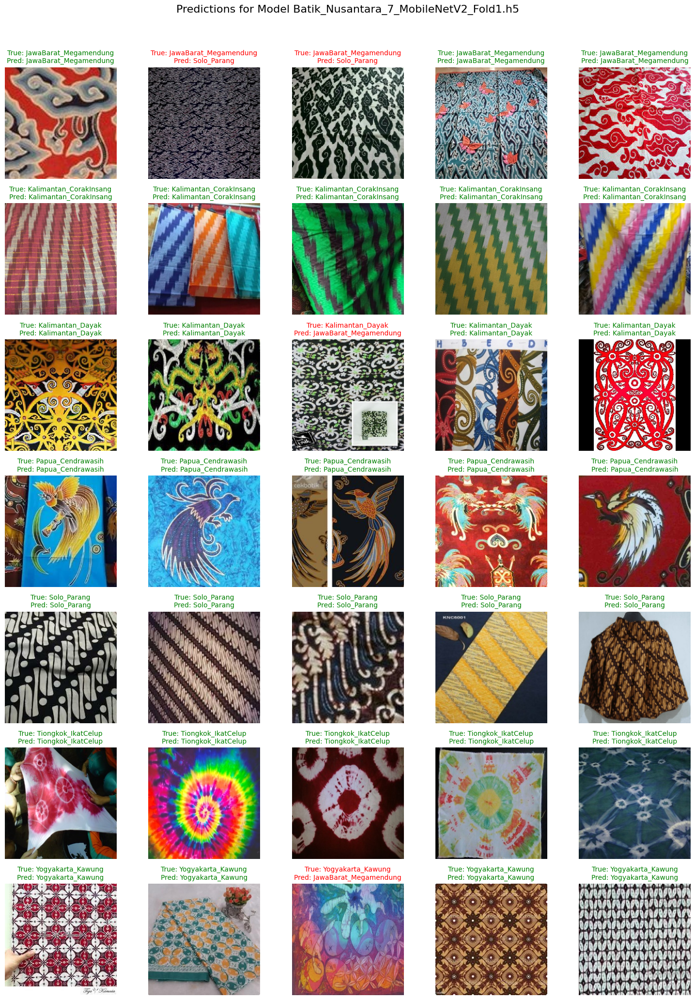

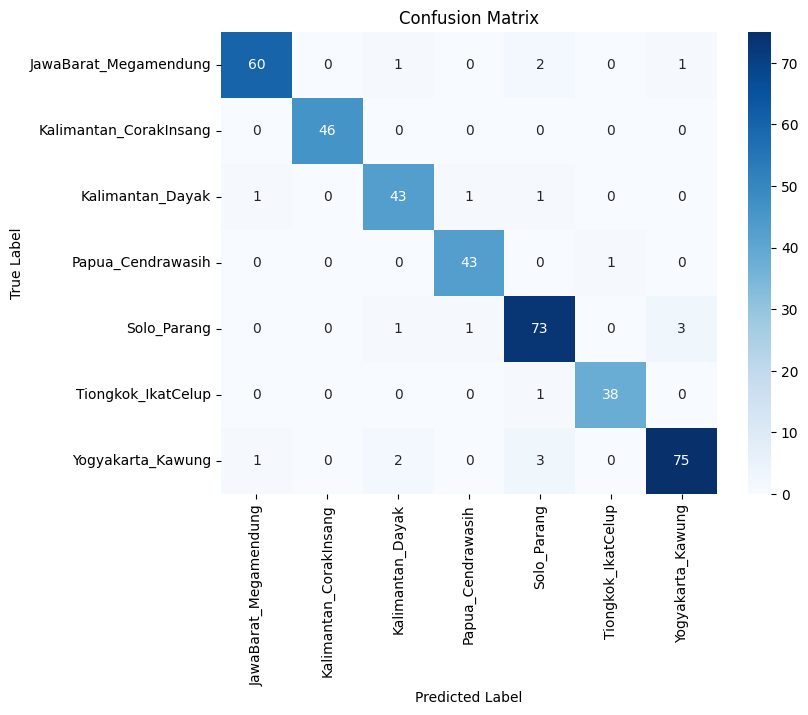

Classification Report:

                        precision    recall  f1-score   support

 JawaBarat_Megamendung       0.97      0.94      0.95        64
Kalimantan_CorakInsang       1.00      1.00      1.00        46
      Kalimantan_Dayak       0.91      0.93      0.92        46
     Papua_Cendrawasih       0.96      0.98      0.97        44
           Solo_Parang       0.91      0.94      0.92        78
    Tiongkok_IkatCelup       0.97      0.97      0.97        39
     Yogyakarta_Kawung       0.95      0.93      0.94        81

              accuracy                           0.95       398
             macro avg       0.95      0.96      0.95       398
          weighted avg       0.95      0.95      0.95       398



In [5]:
import seaborn as sns
from tensorflow.keras.preprocessing import image
from collections import defaultdict

# 🔹 Load model secara manual
model_path = "Batik_Nusantara_7_MobileNetV2_Fold1.h5"  # Ganti dengan model yang ingin diuji
model = tf.keras.models.load_model(model_path)

# 🔹 Lakukan prediksi pada seluruh test set
y_pred_probs = model.predict(test_generator)  # Probabilitas output
y_pred_labels = np.argmax(y_pred_probs, axis=1)  # Konversi ke label prediksi

# 🔹 Ambil informasi dataset dari test_generator
test_filepaths = test_generator.filepaths  # Path gambar dalam test set
y_true_labels = np.array(test_generator.labels)  # Label asli
class_names = list(test_generator.class_indices.keys())  # Nama kelas berdasarkan indeks

# 🔹 Mapping hasil prediksi per kelas
images_per_class = defaultdict(list)
for img_path, true_label, pred_label in zip(test_filepaths, y_true_labels, y_pred_labels):
    images_per_class[class_names[true_label]].append((img_path, class_names[pred_label]))

# 🔹 Menampilkan 5 gambar per kelas
fig, axes = plt.subplots(len(class_names), 5, figsize=(15, len(class_names) * 3))
fig.suptitle(f"Predictions for Model {model_path}", fontsize=16)

for i, class_name in enumerate(class_names):
    image_files = images_per_class[class_name][:5]  # Ambil 5 gambar pertama per kelas

    for j, (img_path, pred_class) in enumerate(image_files):
        img = image.load_img(img_path, target_size=(224, 224))  # Sesuaikan ukuran input model
        
        # 🔹 Tampilkan gambar
        axes[i, j].imshow(img)
        axes[i, j].axis("off")
        
        # 🔹 Warna teks berdasarkan hasil prediksi
        color = "green" if pred_class == class_name else "red"
        axes[i, j].set_title(f"True: {class_name}\nPred: {pred_class}", fontsize=10, color=color)

plt.tight_layout(rect=[0, 0, 1, 0.96])
plt.show()

# 🔹 Confusion Matrix
conf_matrix = confusion_matrix(y_true_labels, y_pred_labels)

plt.figure(figsize=(8, 6))
sns.heatmap(conf_matrix, annot=True, fmt="d", cmap="Blues", xticklabels=class_names, yticklabels=class_names)
plt.xlabel("Predicted Label")
plt.ylabel("True Label")
plt.title("Confusion Matrix")
plt.show()

# 🔹 Classification Report
class_report = classification_report(y_true_labels, y_pred_labels, target_names=class_names)
print("Classification Report:\n")
print(class_report)


C:\Users\VITO KA\AppData\Local\Temp\ipykernel_13788\3700777095.py:18: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=class_names, y=f1_scores, palette="viridis")


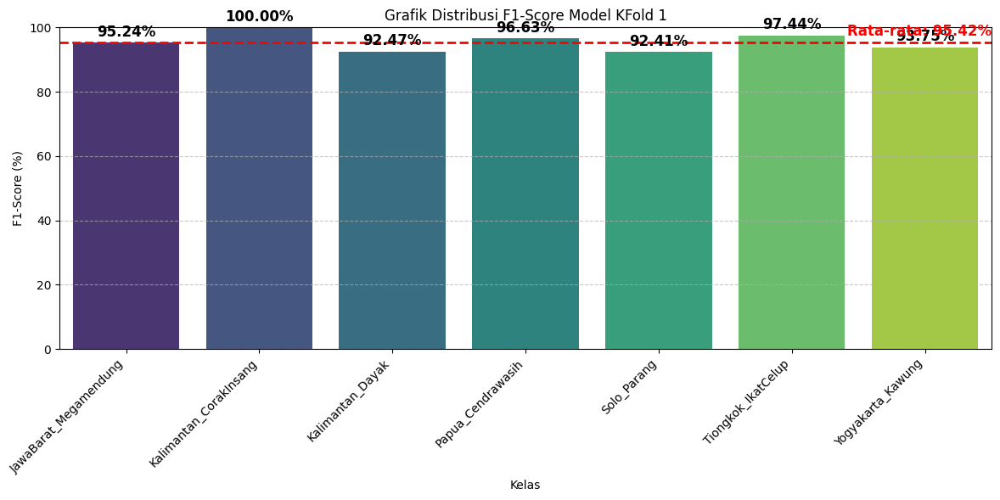

In [6]:
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics import classification_report

# Dapatkan classification report sebagai dictionary
report = classification_report(y_true_labels, y_pred_labels, target_names=class_names, output_dict=True)

# Ambil F1-score per kelas dan konversi ke persen
f1_scores = np.array([report[label]['f1-score'] * 100 for label in class_names])
class_names = np.array(class_names)

# Hitung rata-rata F1-score
average_f1 = np.mean(f1_scores)

# Plot Grafik Batang
plt.figure(figsize=(12, 6))
sns.barplot(x=class_names, y=f1_scores, palette="viridis")

# Tambahkan nilai di atas setiap batang
for i, f1 in enumerate(f1_scores):
    plt.text(i, f1 + 2, f"{f1:.2f}%", ha="center", fontsize=12, fontweight="bold")

# Garis horizontal rata-rata F1-score
plt.axhline(average_f1, color='red', linestyle='--', linewidth=2)

# Teks keterangan rata-rata di pojok kanan atas
plt.text(len(class_names)-0.5, average_f1 + 2,
         f"Rata-rata: {average_f1:.2f}%", color='red',
         fontsize=12, fontweight='bold', ha='right')

plt.ylim(0, 100)
plt.xlabel("Kelas")
plt.ylabel("F1-Score (%)")
plt.title("Grafik Distribusi F1-Score Model KFold 1")
plt.xticks(rotation=45, ha="right", fontsize=10)
plt.tight_layout()
plt.grid(axis="y", linestyle="--", alpha=0.7)

plt.show()


Evaluasi Model KFold 2

13/13 ━━━━━━━━━━━━━━━━━━━━ 18s 1s/step


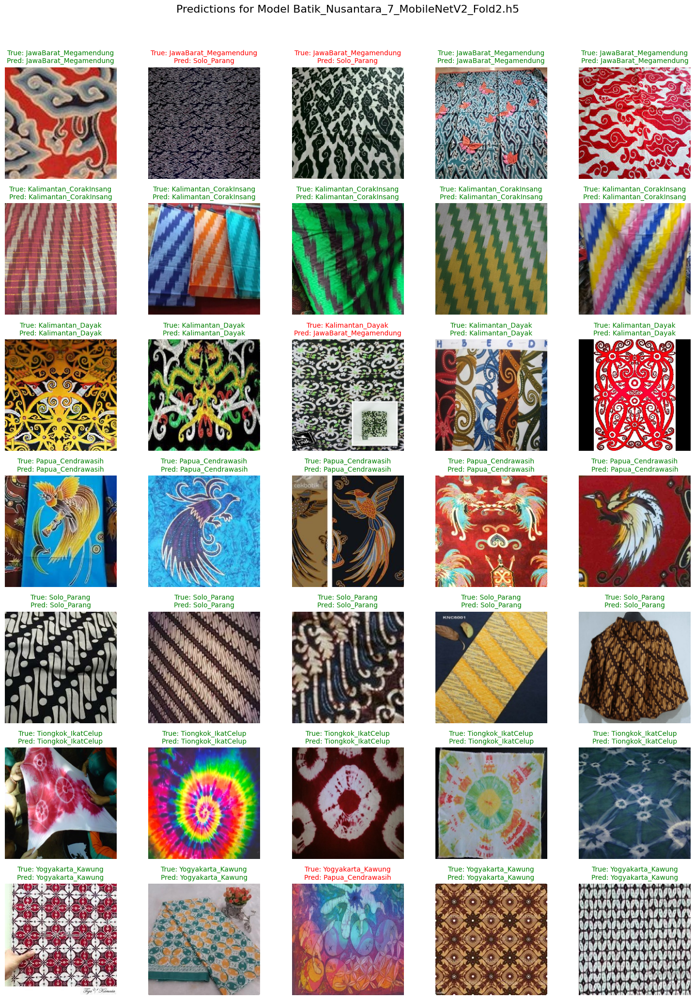

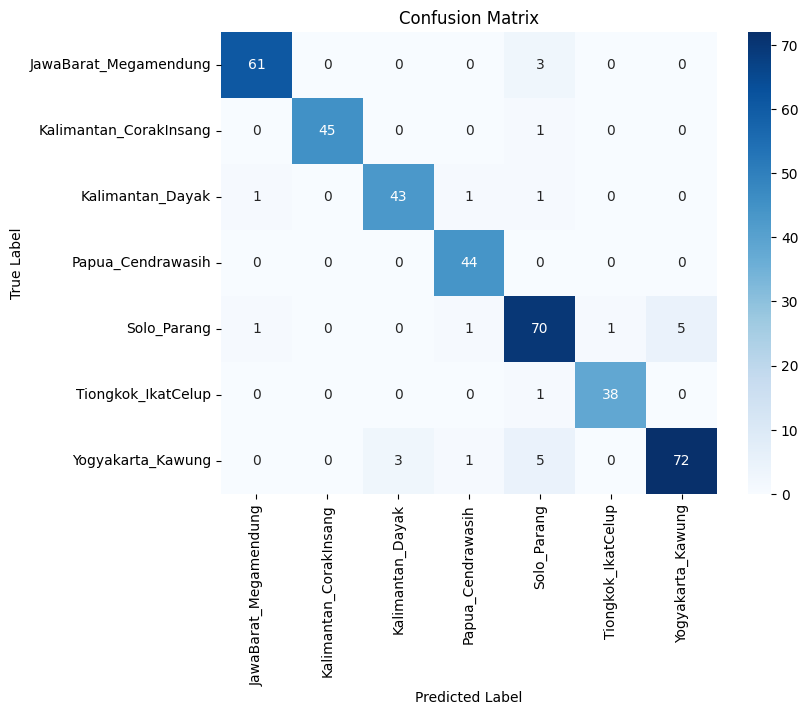

Classification Report:

                        precision    recall  f1-score   support

 JawaBarat_Megamendung       0.97      0.95      0.96        64
Kalimantan_CorakInsang       1.00      0.98      0.99        46
      Kalimantan_Dayak       0.93      0.93      0.93        46
     Papua_Cendrawasih       0.94      1.00      0.97        44
           Solo_Parang       0.86      0.90      0.88        78
    Tiongkok_IkatCelup       0.97      0.97      0.97        39
     Yogyakarta_Kawung       0.94      0.89      0.91        81

              accuracy                           0.94       398
             macro avg       0.94      0.95      0.95       398
          weighted avg       0.94      0.94      0.94       398



In [7]:
import seaborn as sns
from tensorflow.keras.preprocessing import image
from collections import defaultdict

# 🔹 Load model secara manual
model_path = "Batik_Nusantara_7_MobileNetV2_Fold2.h5"  # Ganti dengan model yang ingin diuji
model = tf.keras.models.load_model(model_path)

# 🔹 Lakukan prediksi pada seluruh test set
y_pred_probs = model.predict(test_generator)  # Probabilitas output
y_pred_labels = np.argmax(y_pred_probs, axis=1)  # Konversi ke label prediksi

# 🔹 Ambil informasi dataset dari test_generator
test_filepaths = test_generator.filepaths  # Path gambar dalam test set
y_true_labels = np.array(test_generator.labels)  # Label asli
class_names = list(test_generator.class_indices.keys())  # Nama kelas berdasarkan indeks

# 🔹 Mapping hasil prediksi per kelas
images_per_class = defaultdict(list)
for img_path, true_label, pred_label in zip(test_filepaths, y_true_labels, y_pred_labels):
    images_per_class[class_names[true_label]].append((img_path, class_names[pred_label]))

# 🔹 Menampilkan 5 gambar per kelas
fig, axes = plt.subplots(len(class_names), 5, figsize=(15, len(class_names) * 3))
fig.suptitle(f"Predictions for Model {model_path}", fontsize=16)

for i, class_name in enumerate(class_names):
    image_files = images_per_class[class_name][:5]  # Ambil 5 gambar pertama per kelas

    for j, (img_path, pred_class) in enumerate(image_files):
        img = image.load_img(img_path, target_size=(224, 224))  # Sesuaikan ukuran input model
        
        # 🔹 Tampilkan gambar
        axes[i, j].imshow(img)
        axes[i, j].axis("off")
        
        # 🔹 Warna teks berdasarkan hasil prediksi
        color = "green" if pred_class == class_name else "red"
        axes[i, j].set_title(f"True: {class_name}\nPred: {pred_class}", fontsize=10, color=color)

plt.tight_layout(rect=[0, 0, 1, 0.96])
plt.show()

# 🔹 Confusion Matrix
conf_matrix = confusion_matrix(y_true_labels, y_pred_labels)

plt.figure(figsize=(8, 6))
sns.heatmap(conf_matrix, annot=True, fmt="d", cmap="Blues", xticklabels=class_names, yticklabels=class_names)
plt.xlabel("Predicted Label")
plt.ylabel("True Label")
plt.title("Confusion Matrix")
plt.show()

# 🔹 Classification Report
class_report = classification_report(y_true_labels, y_pred_labels, target_names=class_names)
print("Classification Report:\n")
print(class_report)


C:\Users\VITO KA\AppData\Local\Temp\ipykernel_13788\2186660190.py:18: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=class_names, y=f1_scores, palette="viridis")


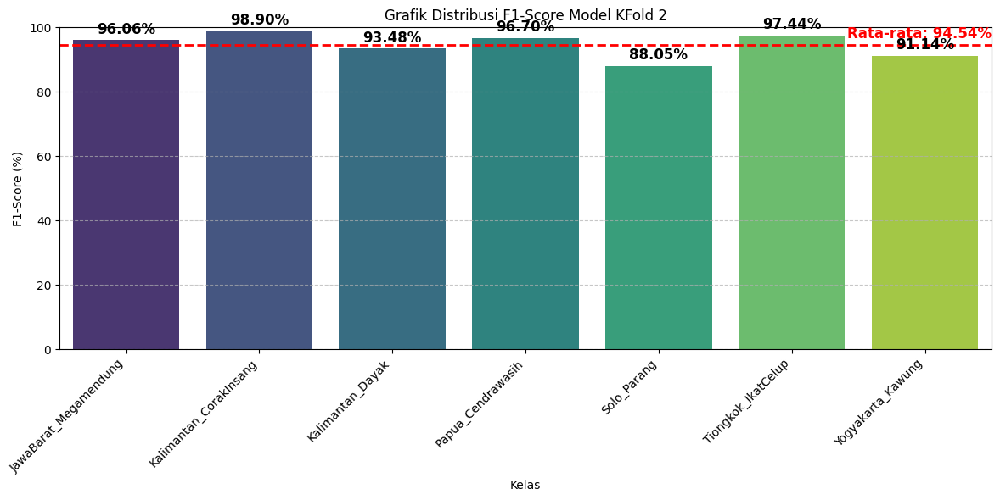

In [8]:
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics import classification_report

# Dapatkan classification report sebagai dictionary
report = classification_report(y_true_labels, y_pred_labels, target_names=class_names, output_dict=True)

# Ambil F1-score per kelas dan konversi ke persen
f1_scores = np.array([report[label]['f1-score'] * 100 for label in class_names])
class_names = np.array(class_names)

# Hitung rata-rata F1-score
average_f1 = np.mean(f1_scores)

# Plot Grafik Batang
plt.figure(figsize=(12, 6))
sns.barplot(x=class_names, y=f1_scores, palette="viridis")

# Tambahkan nilai di atas setiap batang
for i, f1 in enumerate(f1_scores):
    plt.text(i, f1 + 2, f"{f1:.2f}%", ha="center", fontsize=12, fontweight="bold")

# Garis horizontal rata-rata F1-score
plt.axhline(average_f1, color='red', linestyle='--', linewidth=2)

# Teks keterangan rata-rata di pojok kanan atas
plt.text(len(class_names)-0.5, average_f1 + 2,
         f"Rata-rata: {average_f1:.2f}%", color='red',
         fontsize=12, fontweight='bold', ha='right')

plt.ylim(0, 100)
plt.xlabel("Kelas")
plt.ylabel("F1-Score (%)")
plt.title("Grafik Distribusi F1-Score Model KFold 2")
plt.xticks(rotation=45, ha="right", fontsize=10)
plt.tight_layout()
plt.grid(axis="y", linestyle="--", alpha=0.7)

plt.show()


Evaluasi Model KFold 3

13/13 ━━━━━━━━━━━━━━━━━━━━ 10s 714ms/step


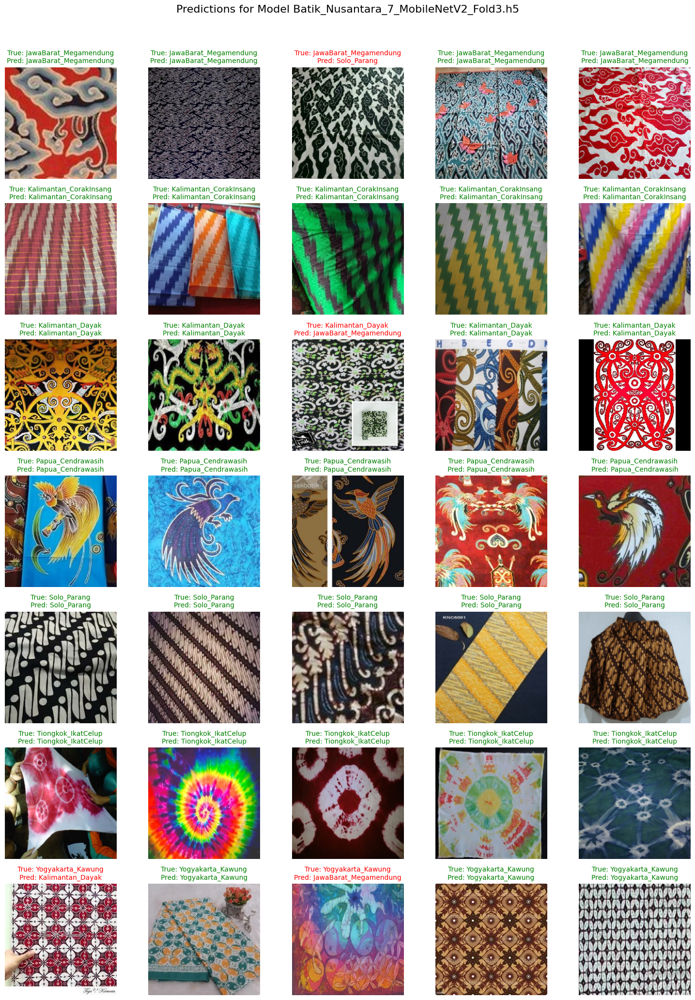

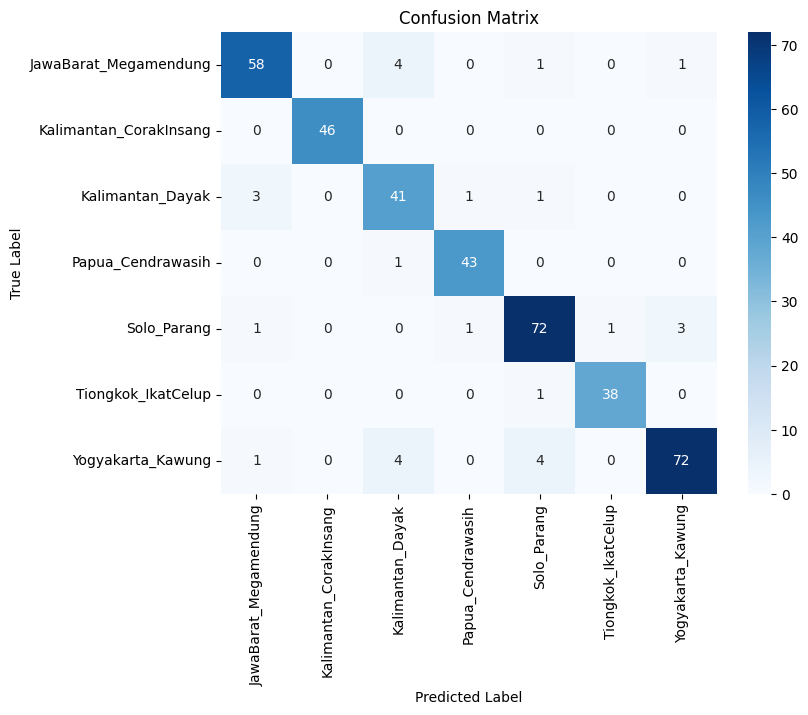

Classification Report:

                        precision    recall  f1-score   support

 JawaBarat_Megamendung       0.92      0.91      0.91        64
Kalimantan_CorakInsang       1.00      1.00      1.00        46
      Kalimantan_Dayak       0.82      0.89      0.85        46
     Papua_Cendrawasih       0.96      0.98      0.97        44
           Solo_Parang       0.91      0.92      0.92        78
    Tiongkok_IkatCelup       0.97      0.97      0.97        39
     Yogyakarta_Kawung       0.95      0.89      0.92        81

              accuracy                           0.93       398
             macro avg       0.93      0.94      0.93       398
          weighted avg       0.93      0.93      0.93       398



In [9]:
import seaborn as sns
from tensorflow.keras.preprocessing import image
from collections import defaultdict

# 🔹 Load model secara manual
model_path = "Batik_Nusantara_7_MobileNetV2_Fold3.h5"  # Ganti dengan model yang ingin diuji
model = tf.keras.models.load_model(model_path)

# 🔹 Lakukan prediksi pada seluruh test set
y_pred_probs = model.predict(test_generator)  # Probabilitas output
y_pred_labels = np.argmax(y_pred_probs, axis=1)  # Konversi ke label prediksi

# 🔹 Ambil informasi dataset dari test_generator
test_filepaths = test_generator.filepaths  # Path gambar dalam test set
y_true_labels = np.array(test_generator.labels)  # Label asli
class_names = list(test_generator.class_indices.keys())  # Nama kelas berdasarkan indeks

# 🔹 Mapping hasil prediksi per kelas
images_per_class = defaultdict(list)
for img_path, true_label, pred_label in zip(test_filepaths, y_true_labels, y_pred_labels):
    images_per_class[class_names[true_label]].append((img_path, class_names[pred_label]))

# 🔹 Menampilkan 5 gambar per kelas
fig, axes = plt.subplots(len(class_names), 5, figsize=(15, len(class_names) * 3))
fig.suptitle(f"Predictions for Model {model_path}", fontsize=16)

for i, class_name in enumerate(class_names):
    image_files = images_per_class[class_name][:5]  # Ambil 5 gambar pertama per kelas

    for j, (img_path, pred_class) in enumerate(image_files):
        img = image.load_img(img_path, target_size=(224, 224))  # Sesuaikan ukuran input model
        
        # 🔹 Tampilkan gambar
        axes[i, j].imshow(img)
        axes[i, j].axis("off")
        
        # 🔹 Warna teks berdasarkan hasil prediksi
        color = "green" if pred_class == class_name else "red"
        axes[i, j].set_title(f"True: {class_name}\nPred: {pred_class}", fontsize=10, color=color)

plt.tight_layout(rect=[0, 0, 1, 0.96])
plt.show()

# 🔹 Confusion Matrix
conf_matrix = confusion_matrix(y_true_labels, y_pred_labels)

plt.figure(figsize=(8, 6))
sns.heatmap(conf_matrix, annot=True, fmt="d", cmap="Blues", xticklabels=class_names, yticklabels=class_names)
plt.xlabel("Predicted Label")
plt.ylabel("True Label")
plt.title("Confusion Matrix")
plt.show()

# 🔹 Classification Report
class_report = classification_report(y_true_labels, y_pred_labels, target_names=class_names)
print("Classification Report:\n")
print(class_report)


C:\Users\VITO KA\AppData\Local\Temp\ipykernel_13788\358054296.py:18: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=class_names, y=f1_scores, palette="viridis")


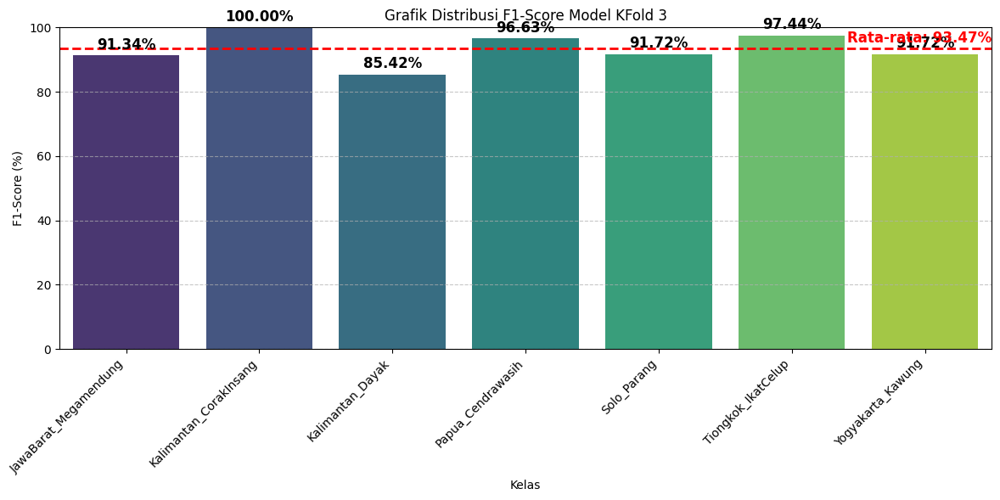

In [10]:
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics import classification_report

# Dapatkan classification report sebagai dictionary
report = classification_report(y_true_labels, y_pred_labels, target_names=class_names, output_dict=True)

# Ambil F1-score per kelas dan konversi ke persen
f1_scores = np.array([report[label]['f1-score'] * 100 for label in class_names])
class_names = np.array(class_names)

# Hitung rata-rata F1-score
average_f1 = np.mean(f1_scores)

# Plot Grafik Batang
plt.figure(figsize=(12, 6))
sns.barplot(x=class_names, y=f1_scores, palette="viridis")

# Tambahkan nilai di atas setiap batang
for i, f1 in enumerate(f1_scores):
    plt.text(i, f1 + 2, f"{f1:.2f}%", ha="center", fontsize=12, fontweight="bold")

# Garis horizontal rata-rata F1-score
plt.axhline(average_f1, color='red', linestyle='--', linewidth=2)

# Teks keterangan rata-rata di pojok kanan atas
plt.text(len(class_names)-0.5, average_f1 + 2,
         f"Rata-rata: {average_f1:.2f}%", color='red',
         fontsize=12, fontweight='bold', ha='right')

plt.ylim(0, 100)
plt.xlabel("Kelas")
plt.ylabel("F1-Score (%)")
plt.title("Grafik Distribusi F1-Score Model KFold 3")
plt.xticks(rotation=45, ha="right", fontsize=10)
plt.tight_layout()
plt.grid(axis="y", linestyle="--", alpha=0.7)

plt.show()


Evaluasi Model KFold 4

13/13 ━━━━━━━━━━━━━━━━━━━━ 14s 990ms/step


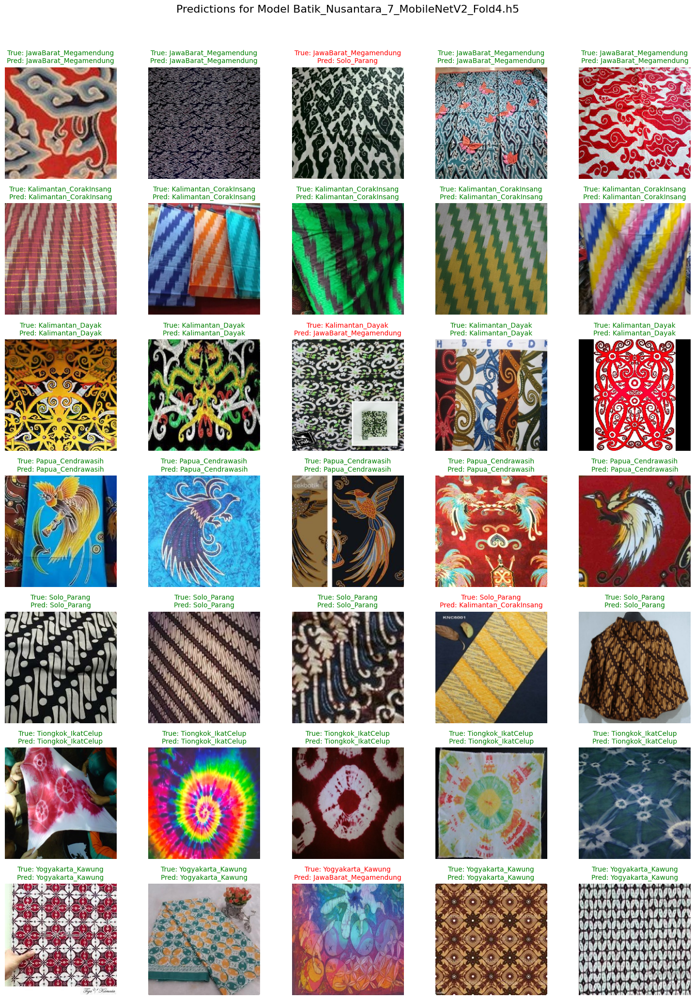

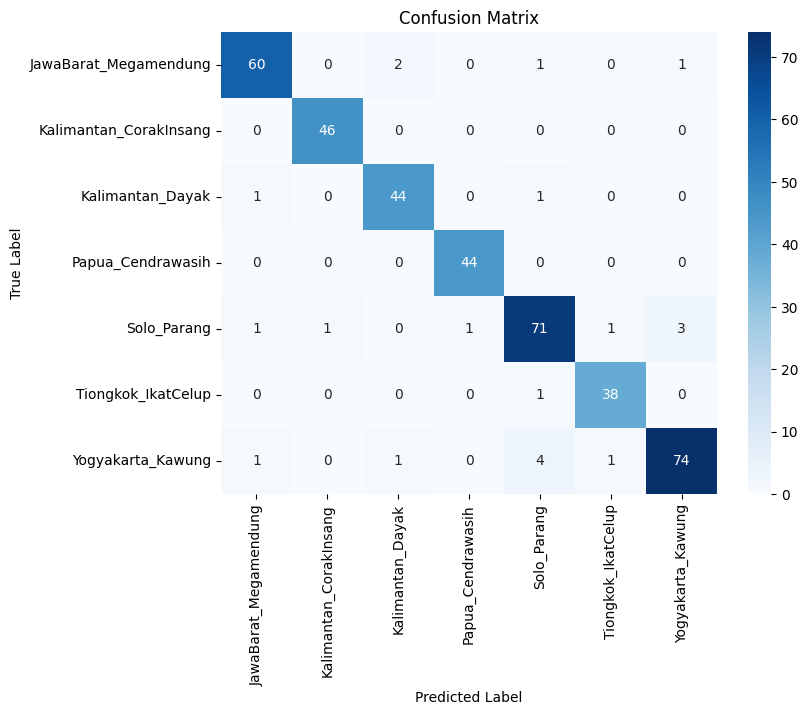

Classification Report:

                        precision    recall  f1-score   support

 JawaBarat_Megamendung       0.95      0.94      0.94        64
Kalimantan_CorakInsang       0.98      1.00      0.99        46
      Kalimantan_Dayak       0.94      0.96      0.95        46
     Papua_Cendrawasih       0.98      1.00      0.99        44
           Solo_Parang       0.91      0.91      0.91        78
    Tiongkok_IkatCelup       0.95      0.97      0.96        39
     Yogyakarta_Kawung       0.95      0.91      0.93        81

              accuracy                           0.95       398
             macro avg       0.95      0.96      0.95       398
          weighted avg       0.95      0.95      0.95       398



In [11]:
import seaborn as sns
from tensorflow.keras.preprocessing import image
from collections import defaultdict

# 🔹 Load model secara manual
model_path = "Batik_Nusantara_7_MobileNetV2_Fold4.h5"  # Ganti dengan model yang ingin diuji
model = tf.keras.models.load_model(model_path)

# 🔹 Lakukan prediksi pada seluruh test set
y_pred_probs = model.predict(test_generator)  # Probabilitas output
y_pred_labels = np.argmax(y_pred_probs, axis=1)  # Konversi ke label prediksi

# 🔹 Ambil informasi dataset dari test_generator
test_filepaths = test_generator.filepaths  # Path gambar dalam test set
y_true_labels = np.array(test_generator.labels)  # Label asli
class_names = list(test_generator.class_indices.keys())  # Nama kelas berdasarkan indeks

# 🔹 Mapping hasil prediksi per kelas
images_per_class = defaultdict(list)
for img_path, true_label, pred_label in zip(test_filepaths, y_true_labels, y_pred_labels):
    images_per_class[class_names[true_label]].append((img_path, class_names[pred_label]))

# 🔹 Menampilkan 5 gambar per kelas
fig, axes = plt.subplots(len(class_names), 5, figsize=(15, len(class_names) * 3))
fig.suptitle(f"Predictions for Model {model_path}", fontsize=16)

for i, class_name in enumerate(class_names):
    image_files = images_per_class[class_name][:5]  # Ambil 5 gambar pertama per kelas

    for j, (img_path, pred_class) in enumerate(image_files):
        img = image.load_img(img_path, target_size=(224, 224))  # Sesuaikan ukuran input model
        
        # 🔹 Tampilkan gambar
        axes[i, j].imshow(img)
        axes[i, j].axis("off")
        
        # 🔹 Warna teks berdasarkan hasil prediksi
        color = "green" if pred_class == class_name else "red"
        axes[i, j].set_title(f"True: {class_name}\nPred: {pred_class}", fontsize=10, color=color)

plt.tight_layout(rect=[0, 0, 1, 0.96])
plt.show()

# 🔹 Confusion Matrix
conf_matrix = confusion_matrix(y_true_labels, y_pred_labels)

plt.figure(figsize=(8, 6))
sns.heatmap(conf_matrix, annot=True, fmt="d", cmap="Blues", xticklabels=class_names, yticklabels=class_names)
plt.xlabel("Predicted Label")
plt.ylabel("True Label")
plt.title("Confusion Matrix")
plt.show()

# 🔹 Classification Report
class_report = classification_report(y_true_labels, y_pred_labels, target_names=class_names)
print("Classification Report:\n")
print(class_report)


C:\Users\VITO KA\AppData\Local\Temp\ipykernel_13788\276641823.py:18: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=class_names, y=f1_scores, palette="viridis")


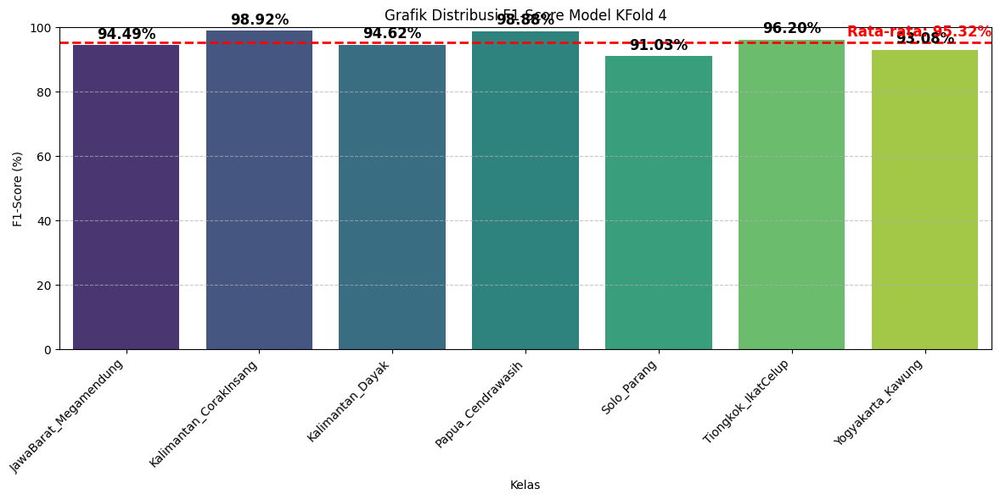

In [12]:
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics import classification_report

# Dapatkan classification report sebagai dictionary
report = classification_report(y_true_labels, y_pred_labels, target_names=class_names, output_dict=True)

# Ambil F1-score per kelas dan konversi ke persen
f1_scores = np.array([report[label]['f1-score'] * 100 for label in class_names])
class_names = np.array(class_names)

# Hitung rata-rata F1-score
average_f1 = np.mean(f1_scores)

# Plot Grafik Batang
plt.figure(figsize=(12, 6))
sns.barplot(x=class_names, y=f1_scores, palette="viridis")

# Tambahkan nilai di atas setiap batang
for i, f1 in enumerate(f1_scores):
    plt.text(i, f1 + 2, f"{f1:.2f}%", ha="center", fontsize=12, fontweight="bold")

# Garis horizontal rata-rata F1-score
plt.axhline(average_f1, color='red', linestyle='--', linewidth=2)

# Teks keterangan rata-rata di pojok kanan atas
plt.text(len(class_names)-0.5, average_f1 + 2,
         f"Rata-rata: {average_f1:.2f}%", color='red',
         fontsize=12, fontweight='bold', ha='right')

plt.ylim(0, 100)
plt.xlabel("Kelas")
plt.ylabel("F1-Score (%)")
plt.title("Grafik Distribusi F1-Score Model KFold 4")
plt.xticks(rotation=45, ha="right", fontsize=10)
plt.tight_layout()
plt.grid(axis="y", linestyle="--", alpha=0.7)

plt.show()


Evaluasi Model KFold 5

13/13 ━━━━━━━━━━━━━━━━━━━━ 13s 897ms/step


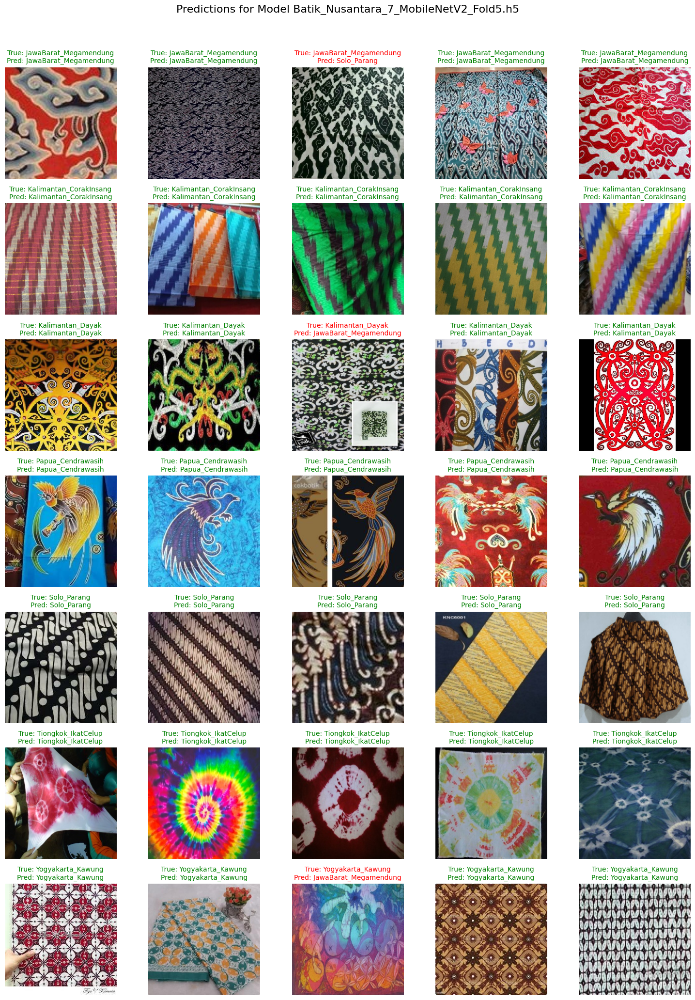

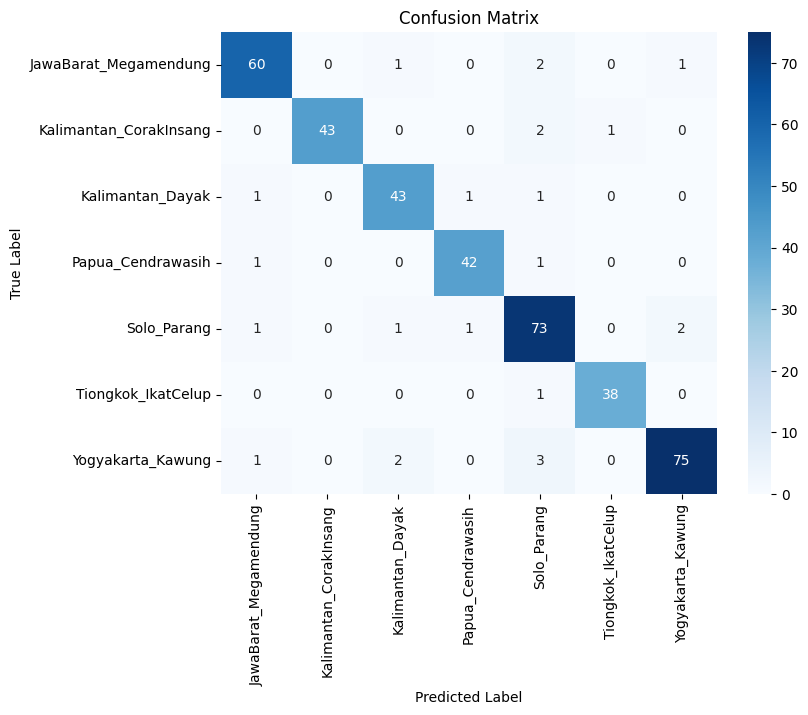

Classification Report:

                        precision    recall  f1-score   support

 JawaBarat_Megamendung       0.94      0.94      0.94        64
Kalimantan_CorakInsang       1.00      0.93      0.97        46
      Kalimantan_Dayak       0.91      0.93      0.92        46
     Papua_Cendrawasih       0.95      0.95      0.95        44
           Solo_Parang       0.88      0.94      0.91        78
    Tiongkok_IkatCelup       0.97      0.97      0.97        39
     Yogyakarta_Kawung       0.96      0.93      0.94        81

              accuracy                           0.94       398
             macro avg       0.95      0.94      0.94       398
          weighted avg       0.94      0.94      0.94       398



In [13]:
import seaborn as sns
from tensorflow.keras.preprocessing import image
from collections import defaultdict

# 🔹 Load model secara manual
model_path = "Batik_Nusantara_7_MobileNetV2_Fold5.h5"  # Ganti dengan model yang ingin diuji
model = tf.keras.models.load_model(model_path)

# 🔹 Lakukan prediksi pada seluruh test set
y_pred_probs = model.predict(test_generator)  # Probabilitas output
y_pred_labels = np.argmax(y_pred_probs, axis=1)  # Konversi ke label prediksi

# 🔹 Ambil informasi dataset dari test_generator
test_filepaths = test_generator.filepaths  # Path gambar dalam test set
y_true_labels = np.array(test_generator.labels)  # Label asli
class_names = list(test_generator.class_indices.keys())  # Nama kelas berdasarkan indeks

# 🔹 Mapping hasil prediksi per kelas
images_per_class = defaultdict(list)
for img_path, true_label, pred_label in zip(test_filepaths, y_true_labels, y_pred_labels):
    images_per_class[class_names[true_label]].append((img_path, class_names[pred_label]))

# 🔹 Menampilkan 5 gambar per kelas
fig, axes = plt.subplots(len(class_names), 5, figsize=(15, len(class_names) * 3))
fig.suptitle(f"Predictions for Model {model_path}", fontsize=16)

for i, class_name in enumerate(class_names):
    image_files = images_per_class[class_name][:5]  # Ambil 5 gambar pertama per kelas

    for j, (img_path, pred_class) in enumerate(image_files):
        img = image.load_img(img_path, target_size=(224, 224))  # Sesuaikan ukuran input model
        
        # 🔹 Tampilkan gambar
        axes[i, j].imshow(img)
        axes[i, j].axis("off")
        
        # 🔹 Warna teks berdasarkan hasil prediksi
        color = "green" if pred_class == class_name else "red"
        axes[i, j].set_title(f"True: {class_name}\nPred: {pred_class}", fontsize=10, color=color)

plt.tight_layout(rect=[0, 0, 1, 0.96])
plt.show()

# 🔹 Confusion Matrix
conf_matrix = confusion_matrix(y_true_labels, y_pred_labels)

plt.figure(figsize=(8, 6))
sns.heatmap(conf_matrix, annot=True, fmt="d", cmap="Blues", xticklabels=class_names, yticklabels=class_names)
plt.xlabel("Predicted Label")
plt.ylabel("True Label")
plt.title("Confusion Matrix")
plt.show()

# 🔹 Classification Report
class_report = classification_report(y_true_labels, y_pred_labels, target_names=class_names)
print("Classification Report:\n")
print(class_report)


C:\Users\VITO KA\AppData\Local\Temp\ipykernel_13788\4055511063.py:18: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=class_names, y=f1_scores, palette="viridis")


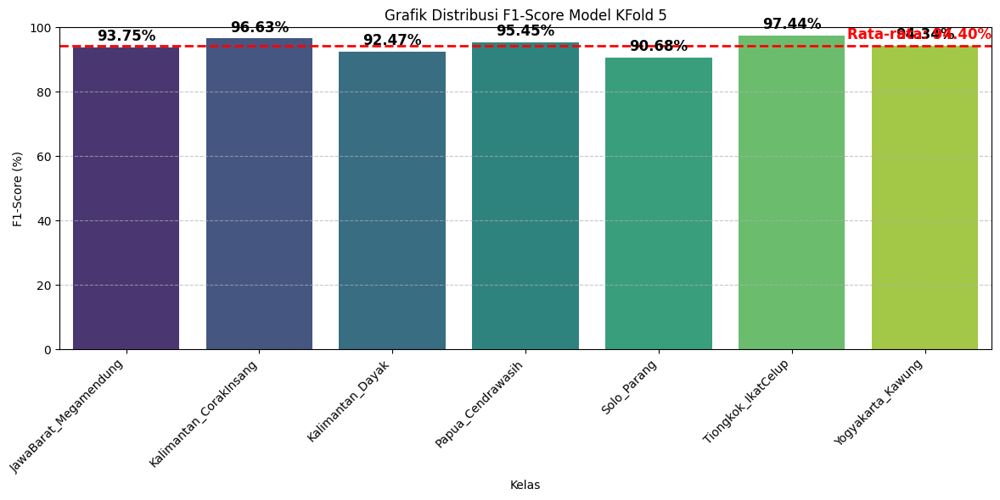

In [14]:
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics import classification_report

# Dapatkan classification report sebagai dictionary
report = classification_report(y_true_labels, y_pred_labels, target_names=class_names, output_dict=True)

# Ambil F1-score per kelas dan konversi ke persen
f1_scores = np.array([report[label]['f1-score'] * 100 for label in class_names])
class_names = np.array(class_names)

# Hitung rata-rata F1-score
average_f1 = np.mean(f1_scores)

# Plot Grafik Batang
plt.figure(figsize=(12, 6))
sns.barplot(x=class_names, y=f1_scores, palette="viridis")

# Tambahkan nilai di atas setiap batang
for i, f1 in enumerate(f1_scores):
    plt.text(i, f1 + 2, f"{f1:.2f}%", ha="center", fontsize=12, fontweight="bold")

# Garis horizontal rata-rata F1-score
plt.axhline(average_f1, color='red', linestyle='--', linewidth=2)

# Teks keterangan rata-rata di pojok kanan atas
plt.text(len(class_names)-0.5, average_f1 + 2,
         f"Rata-rata: {average_f1:.2f}%", color='red',
         fontsize=12, fontweight='bold', ha='right')

plt.ylim(0, 100)
plt.xlabel("Kelas")
plt.ylabel("F1-Score (%)")
plt.title("Grafik Distribusi F1-Score Model KFold 5")
plt.xticks(rotation=45, ha="right", fontsize=10)
plt.tight_layout()
plt.grid(axis="y", linestyle="--", alpha=0.7)

plt.show()


In [20]:
from tensorflow.keras.preprocessing import image

# load model
loaded_model = tf.keras.models.load_model('Batik_Nusantara_7_MobileNetV2_Fold3.h5')

# Path ke direktori dataset
dataset_dir = "../../Dataset/Dataset_Nusantara_7_split_stratified/test"

# Ambil nama kelas dari subdirektori
class_names = sorted(os.listdir(dataset_dir))
print("Nama Kelas:", class_names)

# Load dan preprocess gambar
# img_path = "../../Dataset/Dataset_Nusantara_7_split/test/Papua_Cendrawasih/Papua_Cendrawasih107.jpg"
img_path = "../../test_kawung_foto.jpeg"

img = image.load_img(img_path, target_size=(224, 224))  # Sesuaikan dengan ukuran input model
img_array = image.img_to_array(img)
img_array = np.expand_dims(img_array, axis=0)  # Tambahkan dimensi batch
img_array = preprocess_input(img_array)  # Sesuaikan preprocessing dengan model Anda

# Prediksi
predictions = loaded_model.predict(img_array)
predicted_class_indices = np.argmax(predictions, axis=1)

# Map indeks prediksi ke nama kelas
predicted_class_name = class_names[predicted_class_indices[0]]
print("Predicted Class Index:", predicted_class_indices[0])
print("Predicted Class Name:", predicted_class_name)
print(predictions)

Nama Kelas: ['JawaBarat_Megamendung', 'Kalimantan_CorakInsang', 'Kalimantan_Dayak', 'Papua_Cendrawasih', 'Solo_Parang', 'Tiongkok_IkatCelup', 'Yogyakarta_Kawung']
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 983ms/step
Predicted Class Index: 6
Predicted Class Name: Yogyakarta_Kawung
[[1.7311889e-07 1.7593534e-09 7.0604176e-05 2.5836025e-07 5.4335149e-05
  5.8890259e-07 9.9987411e-01]]


In [1]:
import numpy as np

# Contoh hasil akurasi dari 5 fold 
accuracies = [ 94.97, 93.72, 92.96, 94.72, 93.97 ]

# Menghitung standar deviasi
std_dev = np.std(accuracies)
mean = np.mean(accuracies)

print(f"standar Deviasi Akurasi Model: {std_dev:.4f}")
print(f"Rata-rata akurasi Model: {mean:.4f}")

standar Deviasi Akurasi Model: 0.7207
Rata-rata akurasi Model: 94.0680
